# Afriat

In [1]:
scan=0.18

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: bhm39prh
Name: hokey-council-121
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/bhm39prh
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155910-bhm39prh/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2548,3294,9401
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2548,2569,1655,3442,1663,3366
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4506,10737
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 657,815,2338
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 657,633,453,848,386,833
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1078,2732
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:13<2:19:13, 13.95s/it]

Epoch 1/600:   0%|          | 1/600 [00:13<2:19:13, 13.95s/it, v_num=rh_1, total_loss_train=3.71e+3, kl_local_train=53.8]

Epoch 2/600:   0%|          | 1/600 [00:13<2:19:13, 13.95s/it, v_num=rh_1, total_loss_train=3.71e+3, kl_local_train=53.8]

Epoch 2/600:   0%|          | 2/600 [00:26<2:11:37, 13.21s/it, v_num=rh_1, total_loss_train=3.71e+3, kl_local_train=53.8]

Epoch 2/600:   0%|          | 2/600 [00:26<2:11:37, 13.21s/it, v_num=rh_1, total_loss_train=3.21e+3, kl_local_train=84.3]

Epoch 3/600:   0%|          | 2/600 [00:26<2:11:37, 13.21s/it, v_num=rh_1, total_loss_train=3.21e+3, kl_local_train=84.3]

Epoch 3/600:   0%|          | 3/600 [00:39<2:08:47, 12.94s/it, v_num=rh_1, total_loss_train=3.21e+3, kl_local_train=84.3]

Epoch 3/600:   0%|          | 3/600 [00:39<2:08:47, 12.94s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=85.9] 

Epoch 4/600:   0%|          | 3/600 [00:39<2:08:47, 12.94s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=85.9]

Epoch 4/600:   1%|          | 4/600 [00:51<2:07:43, 12.86s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=85.9]

Epoch 4/600:   1%|          | 4/600 [00:51<2:07:43, 12.86s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=82.2]

Epoch 5/600:   1%|          | 4/600 [00:52<2:07:43, 12.86s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=82.2]

Epoch 5/600:   1%|          | 5/600 [01:04<2:06:46, 12.78s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=82.2]

Epoch 5/600:   1%|          | 5/600 [01:04<2:06:46, 12.78s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=75.3]

Epoch 6/600:   1%|          | 5/600 [01:05<2:06:46, 12.78s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=75.3]

Epoch 6/600:   1%|          | 6/600 [01:17<2:08:10, 12.95s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=75.3]

Epoch 6/600:   1%|          | 6/600 [01:17<2:08:10, 12.95s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=65.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 6/600 [01:17<2:08:10, 12.95s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=65.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:30<2:05:14, 12.67s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=65.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:30<2:05:14, 12.67s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|          | 7/600 [01:30<2:05:14, 12.67s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:42<2:03:02, 12.47s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:42<2:03:02, 12.47s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=33.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 9/600:   1%|▏         | 8/600 [01:42<2:03:02, 12.47s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=33.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:54<2:01:19, 12.32s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=33.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:54<2:01:19, 12.32s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=27.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 9/600 [01:54<2:01:19, 12.32s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=27.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:06<2:00:28, 12.25s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=27.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:06<2:00:28, 12.25s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=29, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]  

Epoch 11/600:   2%|▏         | 10/600 [02:07<2:00:28, 12.25s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=29, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:19<2:03:25, 12.57s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=29, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:19<2:03:25, 12.57s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0226, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.0427]

Epoch 12/600:   2%|▏         | 11/600 [02:19<2:03:25, 12.57s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0226, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.0427]

Epoch 12/600:   2%|▏         | 12/600 [02:31<2:01:31, 12.40s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0226, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.0427]

Epoch 12/600:   2%|▏         | 12/600 [02:31<2:01:31, 12.40s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0226, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.0427]

Epoch 13/600:   2%|▏         | 12/600 [02:31<2:01:31, 12.40s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0226, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.0427]

Epoch 13/600:   2%|▏         | 13/600 [02:43<2:00:05, 12.27s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0226, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.0427]

Epoch 13/600:   2%|▏         | 13/600 [02:43<2:00:05, 12.27s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0226, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.0427]

Epoch 14/600:   2%|▏         | 13/600 [02:43<2:00:05, 12.27s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0226, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.0427]

Epoch 14/600:   2%|▏         | 14/600 [02:55<1:59:00, 12.18s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0226, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.0427]

Epoch 14/600:   2%|▏         | 14/600 [02:55<1:59:00, 12.18s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=58.5, metric_mi|status_control_train=0.0226, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.0427]

Epoch 15/600:   2%|▏         | 14/600 [02:55<1:59:00, 12.18s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=58.5, metric_mi|status_control_train=0.0226, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.0427]

Epoch 15/600:   2%|▎         | 15/600 [03:07<1:58:33, 12.16s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=58.5, metric_mi|status_control_train=0.0226, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.0427]

Epoch 15/600:   2%|▎         | 15/600 [03:07<1:58:33, 12.16s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=63.2, metric_mi|status_control_train=0.0226, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.0427]

Epoch 16/600:   2%|▎         | 15/600 [03:08<1:58:33, 12.16s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=63.2, metric_mi|status_control_train=0.0226, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.0427]

Epoch 16/600:   3%|▎         | 16/600 [03:20<2:01:43, 12.51s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=63.2, metric_mi|status_control_train=0.0226, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.0427]

Epoch 16/600:   3%|▎         | 16/600 [03:20<2:01:43, 12.51s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=71.8, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.063]

Epoch 17/600:   3%|▎         | 16/600 [03:20<2:01:43, 12.51s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=71.8, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.063]

Epoch 17/600:   3%|▎         | 17/600 [03:32<1:59:58, 12.35s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=71.8, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.063]

Epoch 17/600:   3%|▎         | 17/600 [03:32<1:59:58, 12.35s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=81.9, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.063]

Epoch 18/600:   3%|▎         | 17/600 [03:32<1:59:58, 12.35s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=81.9, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.063]

Epoch 18/600:   3%|▎         | 18/600 [03:44<1:58:40, 12.23s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=81.9, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.063]

Epoch 18/600:   3%|▎         | 18/600 [03:44<1:58:40, 12.23s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=91.8, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.063]

Epoch 19/600:   3%|▎         | 18/600 [03:44<1:58:40, 12.23s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=91.8, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.063]

Epoch 19/600:   3%|▎         | 19/600 [03:56<1:57:42, 12.16s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=91.8, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.063]

Epoch 19/600:   3%|▎         | 19/600 [03:56<1:57:42, 12.16s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=104, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.063] 

Epoch 20/600:   3%|▎         | 19/600 [03:56<1:57:42, 12.16s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=104, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.063]

Epoch 20/600:   3%|▎         | 20/600 [04:08<1:57:10, 12.12s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=104, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.063]

Epoch 20/600:   3%|▎         | 20/600 [04:08<1:57:10, 12.12s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.063]

Epoch 21/600:   3%|▎         | 20/600 [04:10<1:57:10, 12.12s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.063]

Epoch 21/600:   4%|▎         | 21/600 [04:22<2:00:30, 12.49s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0704, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.063]

Epoch 21/600:   4%|▎         | 21/600 [04:22<2:00:30, 12.49s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=121, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 22/600:   4%|▎         | 21/600 [04:22<2:00:30, 12.49s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=121, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 22/600:   4%|▎         | 22/600 [04:34<1:58:54, 12.34s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=121, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 22/600:   4%|▎         | 22/600 [04:34<1:58:54, 12.34s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=126, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 23/600:   4%|▎         | 22/600 [04:34<1:58:54, 12.34s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=126, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 23/600:   4%|▍         | 23/600 [04:46<1:57:47, 12.25s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=126, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 23/600:   4%|▍         | 23/600 [04:46<1:57:47, 12.25s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=128, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 24/600:   4%|▍         | 23/600 [04:46<1:57:47, 12.25s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=128, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 24/600:   4%|▍         | 24/600 [04:58<1:57:02, 12.19s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=128, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 24/600:   4%|▍         | 24/600 [04:58<1:57:02, 12.19s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=126, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 25/600:   4%|▍         | 24/600 [04:58<1:57:02, 12.19s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=126, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 25/600:   4%|▍         | 25/600 [05:10<1:56:40, 12.18s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=126, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 25/600:   4%|▍         | 25/600 [05:10<1:56:40, 12.18s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=124, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 26/600:   4%|▍         | 25/600 [05:11<1:56:40, 12.18s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=124, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 26/600:   4%|▍         | 26/600 [05:23<1:59:56, 12.54s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=124, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 26/600:   4%|▍         | 26/600 [05:23<1:59:56, 12.54s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.11]       

Epoch 27/600:   4%|▍         | 26/600 [05:23<1:59:56, 12.54s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.11]

Epoch 27/600:   4%|▍         | 27/600 [05:35<1:58:26, 12.40s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.11]

Epoch 27/600:   4%|▍         | 27/600 [05:35<1:58:26, 12.40s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.11]

Epoch 28/600:   4%|▍         | 27/600 [05:35<1:58:26, 12.40s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.11]

Epoch 28/600:   5%|▍         | 28/600 [05:47<1:56:46, 12.25s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.11]

Epoch 28/600:   5%|▍         | 28/600 [05:47<1:56:46, 12.25s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.11]

Epoch 29/600:   5%|▍         | 28/600 [05:47<1:56:46, 12.25s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.11]

Epoch 29/600:   5%|▍         | 29/600 [05:59<1:55:05, 12.09s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.11]

Epoch 29/600:   5%|▍         | 29/600 [05:59<1:55:05, 12.09s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=108, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.11]

Epoch 30/600:   5%|▍         | 29/600 [05:59<1:55:05, 12.09s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=108, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.11]

Epoch 30/600:   5%|▌         | 30/600 [06:11<1:54:01, 12.00s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=108, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.11]

Epoch 30/600:   5%|▌         | 30/600 [06:11<1:54:01, 12.00s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.11]

Epoch 31/600:   5%|▌         | 30/600 [06:12<1:54:01, 12.00s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.11]

Epoch 31/600:   5%|▌         | 31/600 [06:24<1:56:55, 12.33s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.11]

Epoch 31/600:   5%|▌         | 31/600 [06:24<1:56:55, 12.33s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.117]

Epoch 32/600:   5%|▌         | 31/600 [06:24<1:56:55, 12.33s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.117]

Epoch 32/600:   5%|▌         | 32/600 [06:36<1:55:06, 12.16s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.117]

Epoch 32/600:   5%|▌         | 32/600 [06:36<1:55:06, 12.16s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.117]

Epoch 33/600:   5%|▌         | 32/600 [06:36<1:55:06, 12.16s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.117]

Epoch 33/600:   6%|▌         | 33/600 [06:47<1:53:45, 12.04s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.117]

Epoch 33/600:   6%|▌         | 33/600 [06:47<1:53:45, 12.04s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.117]

Epoch 34/600:   6%|▌         | 33/600 [06:47<1:53:45, 12.04s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.117]

Epoch 34/600:   6%|▌         | 34/600 [06:59<1:52:43, 11.95s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.117]

Epoch 34/600:   6%|▌         | 34/600 [06:59<1:52:43, 11.95s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.117]

Epoch 35/600:   6%|▌         | 34/600 [06:59<1:52:43, 11.95s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.117]

Epoch 35/600:   6%|▌         | 35/600 [07:11<1:52:10, 11.91s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.117]

Epoch 35/600:   6%|▌         | 35/600 [07:11<1:52:10, 11.91s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.117]

Epoch 36/600:   6%|▌         | 35/600 [07:12<1:52:10, 11.91s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.117]

Epoch 36/600:   6%|▌         | 36/600 [07:24<1:55:11, 12.25s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.117]

Epoch 36/600:   6%|▌         | 36/600 [07:24<1:55:11, 12.25s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|▌         | 36/600 [07:24<1:55:11, 12.25s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|▌         | 37/600 [07:36<1:53:39, 12.11s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|▌         | 37/600 [07:36<1:53:39, 12.11s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|▌         | 37/600 [07:36<1:53:39, 12.11s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|▋         | 38/600 [07:48<1:52:30, 12.01s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|▋         | 38/600 [07:48<1:52:30, 12.01s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|▋         | 38/600 [07:48<1:52:30, 12.01s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|▋         | 39/600 [07:59<1:51:40, 11.94s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|▋         | 39/600 [07:59<1:51:40, 11.94s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 40/600:   6%|▋         | 39/600 [07:59<1:51:40, 11.94s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 40/600:   7%|▋         | 40/600 [08:11<1:50:54, 11.88s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 40/600:   7%|▋         | 40/600 [08:11<1:50:54, 11.88s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|▋         | 40/600 [08:12<1:50:54, 11.88s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|▋         | 41/600 [08:24<1:54:00, 12.24s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|▋         | 41/600 [08:24<1:54:00, 12.24s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 42/600:   7%|▋         | 41/600 [08:24<1:54:00, 12.24s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 42/600:   7%|▋         | 42/600 [08:36<1:52:31, 12.10s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 42/600:   7%|▋         | 42/600 [08:36<1:52:31, 12.10s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 43/600:   7%|▋         | 42/600 [08:36<1:52:31, 12.10s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 43/600:   7%|▋         | 43/600 [08:48<1:51:26, 12.00s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 43/600:   7%|▋         | 43/600 [08:48<1:51:26, 12.00s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 44/600:   7%|▋         | 43/600 [08:48<1:51:26, 12.00s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 44/600:   7%|▋         | 44/600 [08:59<1:50:36, 11.94s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 44/600:   7%|▋         | 44/600 [08:59<1:50:36, 11.94s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126] 

Epoch 45/600:   7%|▋         | 44/600 [08:59<1:50:36, 11.94s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 45/600:   8%|▊         | 45/600 [09:11<1:49:55, 11.88s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 45/600:   8%|▊         | 45/600 [09:11<1:49:55, 11.88s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 46/600:   8%|▊         | 45/600 [09:13<1:49:55, 11.88s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 46/600:   8%|▊         | 46/600 [09:24<1:52:47, 12.22s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 46/600:   8%|▊         | 46/600 [09:24<1:52:47, 12.22s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.13] 

Epoch 47/600:   8%|▊         | 46/600 [09:24<1:52:47, 12.22s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.13]

Epoch 47/600:   8%|▊         | 47/600 [09:36<1:51:28, 12.09s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.13]

Epoch 47/600:   8%|▊         | 47/600 [09:36<1:51:28, 12.09s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.13]

Epoch 48/600:   8%|▊         | 47/600 [09:36<1:51:28, 12.09s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.13]

Epoch 48/600:   8%|▊         | 48/600 [09:48<1:50:00, 11.96s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.13]

Epoch 48/600:   8%|▊         | 48/600 [09:48<1:50:00, 11.96s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.13]

Epoch 49/600:   8%|▊         | 48/600 [09:48<1:50:00, 11.96s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.13]

Epoch 49/600:   8%|▊         | 49/600 [09:59<1:48:54, 11.86s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.13]

Epoch 49/600:   8%|▊         | 49/600 [09:59<1:48:54, 11.86s/it, v_num=rh_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.13]

Epoch 50/600:   8%|▊         | 49/600 [09:59<1:48:54, 11.86s/it, v_num=rh_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.13]

Epoch 50/600:   8%|▊         | 50/600 [10:11<1:47:56, 11.78s/it, v_num=rh_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.13]

Epoch 50/600:   8%|▊         | 50/600 [10:11<1:47:56, 11.78s/it, v_num=rh_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.13]

Epoch 51/600:   8%|▊         | 50/600 [10:12<1:47:56, 11.78s/it, v_num=rh_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.13]

Epoch 51/600:   8%|▊         | 51/600 [10:24<1:50:55, 12.12s/it, v_num=rh_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.13]

Epoch 51/600:   8%|▊         | 51/600 [10:24<1:50:55, 12.12s/it, v_num=rh_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 52/600:   8%|▊         | 51/600 [10:24<1:50:55, 12.12s/it, v_num=rh_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 52/600:   9%|▊         | 52/600 [10:35<1:49:22, 11.98s/it, v_num=rh_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 52/600:   9%|▊         | 52/600 [10:35<1:49:22, 11.98s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13] 

Epoch 53/600:   9%|▊         | 52/600 [10:35<1:49:22, 11.98s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 53/600:   9%|▉         | 53/600 [10:47<1:48:12, 11.87s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 53/600:   9%|▉         | 53/600 [10:47<1:48:12, 11.87s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 54/600:   9%|▉         | 53/600 [10:47<1:48:12, 11.87s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 54/600:   9%|▉         | 54/600 [10:59<1:47:31, 11.82s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 54/600:   9%|▉         | 54/600 [10:59<1:47:31, 11.82s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 55/600:   9%|▉         | 54/600 [10:59<1:47:31, 11.82s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 55/600:   9%|▉         | 55/600 [11:10<1:46:42, 11.75s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 55/600:   9%|▉         | 55/600 [11:10<1:46:42, 11.75s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=99.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 56/600:   9%|▉         | 55/600 [11:12<1:46:42, 11.75s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=99.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 56/600:   9%|▉         | 56/600 [11:23<1:49:37, 12.09s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=99.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 56/600:   9%|▉         | 56/600 [11:23<1:49:37, 12.09s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=99.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 57/600:   9%|▉         | 56/600 [11:23<1:49:37, 12.09s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=99.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 57/600:  10%|▉         | 57/600 [11:35<1:48:07, 11.95s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=99.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 57/600:  10%|▉         | 57/600 [11:35<1:48:07, 11.95s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|▉         | 57/600 [11:35<1:48:07, 11.95s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|▉         | 58/600 [11:46<1:47:03, 11.85s/it, v_num=rh_1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|▉         | 58/600 [11:46<1:47:03, 11.85s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=98.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|▉         | 58/600 [11:46<1:47:03, 11.85s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=98.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|▉         | 59/600 [11:58<1:46:14, 11.78s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=98.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|▉         | 59/600 [11:58<1:46:14, 11.78s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=97.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|▉         | 59/600 [11:58<1:46:14, 11.78s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=97.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|█         | 60/600 [12:10<1:45:34, 11.73s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=97.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|█         | 60/600 [12:10<1:45:34, 11.73s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=97, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]  

Epoch 61/600:  10%|█         | 60/600 [12:11<1:45:34, 11.73s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=97, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|█         | 61/600 [12:23<1:48:35, 12.09s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=97, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|█         | 61/600 [12:23<1:48:35, 12.09s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=93.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 62/600:  10%|█         | 61/600 [12:23<1:48:35, 12.09s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=93.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 62/600:  10%|█         | 62/600 [12:34<1:47:13, 11.96s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=93.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 62/600:  10%|█         | 62/600 [12:34<1:47:13, 11.96s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=94.5, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 63/600:  10%|█         | 62/600 [12:34<1:47:13, 11.96s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=94.5, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 63/600:  10%|█         | 63/600 [12:46<1:46:08, 11.86s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=94.5, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 63/600:  10%|█         | 63/600 [12:46<1:46:08, 11.86s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=94, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]  

Epoch 64/600:  10%|█         | 63/600 [12:46<1:46:08, 11.86s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=94, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 64/600:  11%|█         | 64/600 [12:58<1:45:22, 11.80s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=94, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 64/600:  11%|█         | 64/600 [12:58<1:45:22, 11.80s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=93.4, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 65/600:  11%|█         | 64/600 [12:58<1:45:22, 11.80s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=93.4, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 65/600:  11%|█         | 65/600 [13:09<1:44:35, 11.73s/it, v_num=rh_1, total_loss_train=3.19e+3, kl_local_train=93.4, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 65/600:  11%|█         | 65/600 [13:09<1:44:35, 11.73s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=92.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 66/600:  11%|█         | 65/600 [13:10<1:44:35, 11.73s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=92.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 66/600:  11%|█         | 66/600 [13:22<1:47:34, 12.09s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=92.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 66/600:  11%|█         | 66/600 [13:22<1:47:34, 12.09s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=90.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123] 

Epoch 67/600:  11%|█         | 66/600 [13:22<1:47:34, 12.09s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=90.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 67/600:  11%|█         | 67/600 [13:34<1:46:13, 11.96s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=90.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 67/600:  11%|█         | 67/600 [13:34<1:46:13, 11.96s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=90.9, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 68/600:  11%|█         | 67/600 [13:34<1:46:13, 11.96s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=90.9, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 68/600:  11%|█▏        | 68/600 [13:45<1:45:13, 11.87s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=90.9, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 68/600:  11%|█▏        | 68/600 [13:45<1:45:13, 11.87s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=90.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 69/600:  11%|█▏        | 68/600 [13:45<1:45:13, 11.87s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=90.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 69/600:  12%|█▏        | 69/600 [13:57<1:44:46, 11.84s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=90.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 69/600:  12%|█▏        | 69/600 [13:57<1:44:46, 11.84s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=89, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]  

Epoch 70/600:  12%|█▏        | 69/600 [13:57<1:44:46, 11.84s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=89, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 70/600:  12%|█▏        | 70/600 [14:09<1:44:34, 11.84s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=89, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 70/600:  12%|█▏        | 70/600 [14:09<1:44:34, 11.84s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=89.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 71/600:  12%|█▏        | 70/600 [14:10<1:44:34, 11.84s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=89.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 71/600:  12%|█▏        | 71/600 [14:22<1:47:43, 12.22s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=89.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 71/600:  12%|█▏        | 71/600 [14:22<1:47:43, 12.22s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=88.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 72/600:  12%|█▏        | 71/600 [14:22<1:47:43, 12.22s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=88.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 72/600:  12%|█▏        | 72/600 [14:34<1:46:19, 12.08s/it, v_num=rh_1, total_loss_train=3.18e+3, kl_local_train=88.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 72/600:  12%|█▏        | 72/600 [14:34<1:46:19, 12.08s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=87.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 73/600:  12%|█▏        | 72/600 [14:34<1:46:19, 12.08s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=87.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 73/600:  12%|█▏        | 73/600 [14:46<1:45:24, 12.00s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=87.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 73/600:  12%|█▏        | 73/600 [14:46<1:45:24, 12.00s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=87.3, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 74/600:  12%|█▏        | 73/600 [14:46<1:45:24, 12.00s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=87.3, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 74/600:  12%|█▏        | 74/600 [14:57<1:44:27, 11.92s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=87.3, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 74/600:  12%|█▏        | 74/600 [14:57<1:44:27, 11.92s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=87.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 75/600:  12%|█▏        | 74/600 [14:57<1:44:27, 11.92s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=87.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 75/600:  12%|█▎        | 75/600 [15:09<1:43:43, 11.85s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=87.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 75/600:  12%|█▎        | 75/600 [15:09<1:43:43, 11.85s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=86, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]  

Epoch 76/600:  12%|█▎        | 75/600 [15:10<1:43:43, 11.85s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=86, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 76/600:  13%|█▎        | 76/600 [15:22<1:46:27, 12.19s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=86, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 76/600:  13%|█▎        | 76/600 [15:22<1:46:27, 12.19s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=86.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 77/600:  13%|█▎        | 76/600 [15:22<1:46:27, 12.19s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=86.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 77/600:  13%|█▎        | 77/600 [15:34<1:44:54, 12.04s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=86.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 77/600:  13%|█▎        | 77/600 [15:34<1:44:54, 12.04s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=86.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 78/600:  13%|█▎        | 77/600 [15:34<1:44:54, 12.04s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=86.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 78/600:  13%|█▎        | 78/600 [15:45<1:43:47, 11.93s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=86.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 78/600:  13%|█▎        | 78/600 [15:45<1:43:47, 11.93s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=85.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 79/600:  13%|█▎        | 78/600 [15:45<1:43:47, 11.93s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=85.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 79/600:  13%|█▎        | 79/600 [15:57<1:42:57, 11.86s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=85.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 79/600:  13%|█▎        | 79/600 [15:57<1:42:57, 11.86s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=84.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 80/600:  13%|█▎        | 79/600 [15:57<1:42:57, 11.86s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=84.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 80/600:  13%|█▎        | 80/600 [16:09<1:42:10, 11.79s/it, v_num=rh_1, total_loss_train=3.17e+3, kl_local_train=84.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 80/600:  13%|█▎        | 80/600 [16:09<1:42:10, 11.79s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=85, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]  

Epoch 81/600:  13%|█▎        | 80/600 [16:10<1:42:10, 11.79s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=85, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 81/600:  14%|█▎        | 81/600 [16:22<1:45:05, 12.15s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=85, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 81/600:  14%|█▎        | 81/600 [16:22<1:45:05, 12.15s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=84.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 82/600:  14%|█▎        | 81/600 [16:22<1:45:05, 12.15s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=84.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 82/600:  14%|█▎        | 82/600 [16:33<1:43:42, 12.01s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=84.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 82/600:  14%|█▎        | 82/600 [16:33<1:43:42, 12.01s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=83.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 83/600:  14%|█▎        | 82/600 [16:33<1:43:42, 12.01s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=83.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 83/600:  14%|█▍        | 83/600 [16:45<1:42:39, 11.91s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=83.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 83/600:  14%|█▍        | 83/600 [16:45<1:42:39, 11.91s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=83.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 84/600:  14%|█▍        | 83/600 [16:45<1:42:39, 11.91s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=83.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 84/600:  14%|█▍        | 84/600 [16:57<1:41:52, 11.85s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=83.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 84/600:  14%|█▍        | 84/600 [16:57<1:41:52, 11.85s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=82.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 85/600:  14%|█▍        | 84/600 [16:57<1:41:52, 11.85s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=82.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 85/600:  14%|█▍        | 85/600 [17:08<1:41:07, 11.78s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=82.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 85/600:  14%|█▍        | 85/600 [17:08<1:41:07, 11.78s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=82.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 86/600:  14%|█▍        | 85/600 [17:10<1:41:07, 11.78s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=82.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 86/600:  14%|█▍        | 86/600 [17:21<1:44:00, 12.14s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=82.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 86/600:  14%|█▍        | 86/600 [17:21<1:44:00, 12.14s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=82.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 87/600:  14%|█▍        | 86/600 [17:21<1:44:00, 12.14s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=82.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 87/600:  14%|█▍        | 87/600 [17:33<1:42:40, 12.01s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=82.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 87/600:  14%|█▍        | 87/600 [17:33<1:42:40, 12.01s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=82.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 88/600:  14%|█▍        | 87/600 [17:33<1:42:40, 12.01s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=82.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 88/600:  15%|█▍        | 88/600 [17:45<1:41:40, 11.91s/it, v_num=rh_1, total_loss_train=3.16e+3, kl_local_train=82.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 88/600:  15%|█▍        | 88/600 [17:45<1:41:40, 11.91s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=81.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 89/600:  15%|█▍        | 88/600 [17:45<1:41:40, 11.91s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=81.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 89/600:  15%|█▍        | 89/600 [17:56<1:40:52, 11.85s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=81.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 89/600:  15%|█▍        | 89/600 [17:56<1:40:52, 11.85s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=81.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 90/600:  15%|█▍        | 89/600 [17:56<1:40:52, 11.85s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=81.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 90/600:  15%|█▌        | 90/600 [18:08<1:40:12, 11.79s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=81.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 90/600:  15%|█▌        | 90/600 [18:08<1:40:12, 11.79s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=80.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 91/600:  15%|█▌        | 90/600 [18:09<1:40:12, 11.79s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=80.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 91/600:  15%|█▌        | 91/600 [18:21<1:43:03, 12.15s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=80.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 91/600:  15%|█▌        | 91/600 [18:21<1:43:03, 12.15s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=79.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121] 

Epoch 92/600:  15%|█▌        | 91/600 [18:21<1:43:03, 12.15s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=79.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 92/600:  15%|█▌        | 92/600 [18:33<1:41:44, 12.02s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=79.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 92/600:  15%|█▌        | 92/600 [18:33<1:41:44, 12.02s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=79.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 93/600:  15%|█▌        | 92/600 [18:33<1:41:44, 12.02s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=79.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 93/600:  16%|█▌        | 93/600 [18:45<1:40:43, 11.92s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=79.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 93/600:  16%|█▌        | 93/600 [18:45<1:40:43, 11.92s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=79.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 94/600:  16%|█▌        | 93/600 [18:45<1:40:43, 11.92s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=79.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 94/600:  16%|█▌        | 94/600 [18:56<1:39:59, 11.86s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=79.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 94/600:  16%|█▌        | 94/600 [18:56<1:39:59, 11.86s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=79.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 95/600:  16%|█▌        | 94/600 [18:56<1:39:59, 11.86s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=79.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 95/600:  16%|█▌        | 95/600 [19:08<1:39:22, 11.81s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=79.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 95/600:  16%|█▌        | 95/600 [19:08<1:39:22, 11.81s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=79, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]  

Epoch 96/600:  16%|█▌        | 95/600 [19:09<1:39:22, 11.81s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=79, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 96/600:  16%|█▌        | 96/600 [19:21<1:42:07, 12.16s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=79, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 96/600:  16%|█▌        | 96/600 [19:21<1:42:07, 12.16s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=78.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 97/600:  16%|█▌        | 96/600 [19:21<1:42:07, 12.16s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=78.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 97/600:  16%|█▌        | 97/600 [19:33<1:40:47, 12.02s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=78.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 97/600:  16%|█▌        | 97/600 [19:33<1:40:47, 12.02s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=78, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]  

Epoch 98/600:  16%|█▌        | 97/600 [19:33<1:40:47, 12.02s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=78, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 98/600:  16%|█▋        | 98/600 [19:44<1:40:09, 11.97s/it, v_num=rh_1, total_loss_train=3.15e+3, kl_local_train=78, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 98/600:  16%|█▋        | 98/600 [19:44<1:40:09, 11.97s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=77.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 99/600:  16%|█▋        | 98/600 [19:44<1:40:09, 11.97s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=77.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 99/600:  16%|█▋        | 99/600 [19:56<1:39:21, 11.90s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=77.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 99/600:  16%|█▋        | 99/600 [19:56<1:39:21, 11.90s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=77.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 100/600:  16%|█▋        | 99/600 [19:56<1:39:21, 11.90s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=77.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 100/600:  17%|█▋        | 100/600 [20:08<1:38:30, 11.82s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=77.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 100/600:  17%|█▋        | 100/600 [20:08<1:38:30, 11.82s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=77.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 101/600:  17%|█▋        | 100/600 [20:09<1:38:30, 11.82s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=77.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 101/600:  17%|█▋        | 101/600 [20:21<1:41:13, 12.17s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=77.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 101/600:  17%|█▋        | 101/600 [20:21<1:41:13, 12.17s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=76.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 102/600:  17%|█▋        | 101/600 [20:21<1:41:13, 12.17s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=76.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 102/600:  17%|█▋        | 102/600 [20:33<1:39:50, 12.03s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=76.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 102/600:  17%|█▋        | 102/600 [20:33<1:39:50, 12.03s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=76.1, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 103/600:  17%|█▋        | 102/600 [20:33<1:39:50, 12.03s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=76.1, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 103/600:  17%|█▋        | 103/600 [20:44<1:38:46, 11.93s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=76.1, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 103/600:  17%|█▋        | 103/600 [20:44<1:38:46, 11.93s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=76.1, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 104/600:  17%|█▋        | 103/600 [20:44<1:38:46, 11.93s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=76.1, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 104/600:  17%|█▋        | 104/600 [20:56<1:37:58, 11.85s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=76.1, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 104/600:  17%|█▋        | 104/600 [20:56<1:37:58, 11.85s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=75.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 105/600:  17%|█▋        | 104/600 [20:56<1:37:58, 11.85s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=75.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 105/600:  18%|█▊        | 105/600 [21:08<1:37:20, 11.80s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=75.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 105/600:  18%|█▊        | 105/600 [21:08<1:37:20, 11.80s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=75.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 106/600:  18%|█▊        | 105/600 [21:09<1:37:20, 11.80s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=75.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 106/600:  18%|█▊        | 106/600 [21:21<1:40:02, 12.15s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=75.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 106/600:  18%|█▊        | 106/600 [21:21<1:40:02, 12.15s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=75.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.119]

Epoch 107/600:  18%|█▊        | 106/600 [21:21<1:40:02, 12.15s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=75.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.119]

Epoch 107/600:  18%|█▊        | 107/600 [21:32<1:38:42, 12.01s/it, v_num=rh_1, total_loss_train=3.14e+3, kl_local_train=75.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.119]

Epoch 107/600:  18%|█▊        | 107/600 [21:32<1:38:42, 12.01s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=74.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.119]

Epoch 108/600:  18%|█▊        | 107/600 [21:32<1:38:42, 12.01s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=74.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.119]

Epoch 108/600:  18%|█▊        | 108/600 [21:44<1:37:40, 11.91s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=74.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.119]

Epoch 108/600:  18%|█▊        | 108/600 [21:44<1:37:40, 11.91s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=74.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.119]

Epoch 109/600:  18%|█▊        | 108/600 [21:44<1:37:40, 11.91s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=74.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.119]

Epoch 109/600:  18%|█▊        | 109/600 [21:56<1:36:56, 11.85s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=74.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.119]

Epoch 109/600:  18%|█▊        | 109/600 [21:56<1:36:56, 11.85s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=74.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.119]

Epoch 110/600:  18%|█▊        | 109/600 [21:56<1:36:56, 11.85s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=74.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.119]

Epoch 110/600:  18%|█▊        | 110/600 [22:07<1:36:23, 11.80s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=74.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.119]

Epoch 110/600:  18%|█▊        | 110/600 [22:07<1:36:23, 11.80s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=74.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.119]

Epoch 111/600:  18%|█▊        | 110/600 [22:09<1:36:23, 11.80s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=74.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.119]

Epoch 111/600:  18%|█▊        | 111/600 [22:20<1:39:01, 12.15s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=74.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.119]

Epoch 111/600:  18%|█▊        | 111/600 [22:20<1:39:01, 12.15s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=73.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 112/600:  18%|█▊        | 111/600 [22:20<1:39:01, 12.15s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=73.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 112/600:  19%|█▊        | 112/600 [22:32<1:37:41, 12.01s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=73.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 112/600:  19%|█▊        | 112/600 [22:32<1:37:41, 12.01s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=73.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 113/600:  19%|█▊        | 112/600 [22:32<1:37:41, 12.01s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=73.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 113/600:  19%|█▉        | 113/600 [22:44<1:36:43, 11.92s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=73.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 113/600:  19%|█▉        | 113/600 [22:44<1:36:43, 11.92s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=72.8, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 114/600:  19%|█▉        | 113/600 [22:44<1:36:43, 11.92s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=72.8, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 114/600:  19%|█▉        | 114/600 [22:55<1:35:58, 11.85s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=72.8, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 114/600:  19%|█▉        | 114/600 [22:55<1:35:58, 11.85s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=72.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 115/600:  19%|█▉        | 114/600 [22:55<1:35:58, 11.85s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=72.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 115/600:  19%|█▉        | 115/600 [23:07<1:35:19, 11.79s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=72.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 115/600:  19%|█▉        | 115/600 [23:07<1:35:19, 11.79s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=72.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 116/600:  19%|█▉        | 115/600 [23:08<1:35:19, 11.79s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=72.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 116/600:  19%|█▉        | 116/600 [23:20<1:37:59, 12.15s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=72.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.117]

Epoch 116/600:  19%|█▉        | 116/600 [23:20<1:37:59, 12.15s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=72.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 117/600:  19%|█▉        | 116/600 [23:20<1:37:59, 12.15s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=72.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 117/600:  20%|█▉        | 117/600 [23:32<1:36:40, 12.01s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=72.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 117/600:  20%|█▉        | 117/600 [23:32<1:36:40, 12.01s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=72.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 118/600:  20%|█▉        | 117/600 [23:32<1:36:40, 12.01s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=72.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 118/600:  20%|█▉        | 118/600 [23:43<1:35:42, 11.91s/it, v_num=rh_1, total_loss_train=3.13e+3, kl_local_train=72.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 118/600:  20%|█▉        | 118/600 [23:43<1:35:42, 11.91s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=72, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]  

Epoch 119/600:  20%|█▉        | 118/600 [23:43<1:35:42, 11.91s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=72, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 119/600:  20%|█▉        | 119/600 [23:55<1:35:00, 11.85s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=72, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 119/600:  20%|█▉        | 119/600 [23:55<1:35:00, 11.85s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=71.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 120/600:  20%|█▉        | 119/600 [23:55<1:35:00, 11.85s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=71.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 120/600:  20%|██        | 120/600 [24:07<1:34:31, 11.82s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=71.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 120/600:  20%|██        | 120/600 [24:07<1:34:31, 11.82s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=71.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 121/600:  20%|██        | 120/600 [24:08<1:34:31, 11.82s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=71.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 121/600:  20%|██        | 121/600 [24:20<1:37:04, 12.16s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=71.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 121/600:  20%|██        | 121/600 [24:20<1:37:04, 12.16s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=71.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11] 

Epoch 122/600:  20%|██        | 121/600 [24:20<1:37:04, 12.16s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=71.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 122/600:  20%|██        | 122/600 [24:31<1:35:46, 12.02s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=71.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 122/600:  20%|██        | 122/600 [24:31<1:35:46, 12.02s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=71.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 123/600:  20%|██        | 122/600 [24:31<1:35:46, 12.02s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=71.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 123/600:  20%|██        | 123/600 [24:43<1:34:48, 11.93s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=71.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 123/600:  20%|██        | 123/600 [24:43<1:34:48, 11.93s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=70.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 124/600:  20%|██        | 123/600 [24:43<1:34:48, 11.93s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=70.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 124/600:  21%|██        | 124/600 [24:55<1:34:25, 11.90s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=70.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 124/600:  21%|██        | 124/600 [24:55<1:34:25, 11.90s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=70.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 125/600:  21%|██        | 124/600 [24:55<1:34:25, 11.90s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=70.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 125/600:  21%|██        | 125/600 [25:07<1:34:01, 11.88s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=70.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 125/600:  21%|██        | 125/600 [25:07<1:34:01, 11.88s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=70.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 126/600:  21%|██        | 125/600 [25:08<1:34:01, 11.88s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=70.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 126/600:  21%|██        | 126/600 [25:20<1:37:08, 12.30s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=70.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 126/600:  21%|██        | 126/600 [25:20<1:37:08, 12.30s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108] 

Epoch 127/600:  21%|██        | 126/600 [25:20<1:37:08, 12.30s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 127/600:  21%|██        | 127/600 [25:32<1:36:10, 12.20s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 127/600:  21%|██        | 127/600 [25:32<1:36:10, 12.20s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=70.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 128/600:  21%|██        | 127/600 [25:32<1:36:10, 12.20s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=70.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 128/600:  21%|██▏       | 128/600 [25:44<1:35:22, 12.12s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=70.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 128/600:  21%|██▏       | 128/600 [25:44<1:35:22, 12.12s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=69.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 129/600:  21%|██▏       | 128/600 [25:44<1:35:22, 12.12s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=69.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 129/600:  22%|██▏       | 129/600 [25:56<1:34:57, 12.10s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=69.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 129/600:  22%|██▏       | 129/600 [25:56<1:34:57, 12.10s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=69.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 130/600:  22%|██▏       | 129/600 [25:56<1:34:57, 12.10s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=69.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 130/600:  22%|██▏       | 130/600 [26:08<1:34:33, 12.07s/it, v_num=rh_1, total_loss_train=3.12e+3, kl_local_train=69.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 130/600:  22%|██▏       | 130/600 [26:08<1:34:33, 12.07s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=68.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 131/600:  22%|██▏       | 130/600 [26:09<1:34:33, 12.07s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=68.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 131/600:  22%|██▏       | 131/600 [26:21<1:37:22, 12.46s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=68.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 131/600:  22%|██▏       | 131/600 [26:21<1:37:22, 12.46s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=69.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 132/600:  22%|██▏       | 131/600 [26:21<1:37:22, 12.46s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=69.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 132/600:  22%|██▏       | 132/600 [26:33<1:36:18, 12.35s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=69.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 132/600:  22%|██▏       | 132/600 [26:33<1:36:18, 12.35s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=69, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]  

Epoch 133/600:  22%|██▏       | 132/600 [26:34<1:36:18, 12.35s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=69, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 133/600:  22%|██▏       | 133/600 [26:46<1:35:28, 12.27s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=69, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 133/600:  22%|██▏       | 133/600 [26:46<1:35:28, 12.27s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=68.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 134/600:  22%|██▏       | 133/600 [26:46<1:35:28, 12.27s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=68.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 134/600:  22%|██▏       | 134/600 [26:58<1:34:50, 12.21s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=68.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 134/600:  22%|██▏       | 134/600 [26:58<1:34:50, 12.21s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=68.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 135/600:  22%|██▏       | 134/600 [26:58<1:34:50, 12.21s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=68.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 135/600:  22%|██▎       | 135/600 [27:10<1:34:59, 12.26s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=68.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 135/600:  22%|██▎       | 135/600 [27:10<1:34:59, 12.26s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 136/600:  22%|██▎       | 135/600 [27:11<1:34:59, 12.26s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 136/600:  23%|██▎       | 136/600 [27:23<1:37:17, 12.58s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 136/600:  23%|██▎       | 136/600 [27:23<1:37:17, 12.58s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 137/600:  23%|██▎       | 136/600 [27:23<1:37:17, 12.58s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 137/600:  23%|██▎       | 137/600 [27:35<1:35:49, 12.42s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 137/600:  23%|██▎       | 137/600 [27:35<1:35:49, 12.42s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 138/600:  23%|██▎       | 137/600 [27:35<1:35:49, 12.42s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 138/600:  23%|██▎       | 138/600 [27:47<1:34:45, 12.31s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 138/600:  23%|██▎       | 138/600 [27:47<1:34:45, 12.31s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 139/600:  23%|██▎       | 138/600 [27:47<1:34:45, 12.31s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 139/600:  23%|██▎       | 139/600 [27:59<1:33:54, 12.22s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 139/600:  23%|██▎       | 139/600 [27:59<1:33:54, 12.22s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 140/600:  23%|██▎       | 139/600 [27:59<1:33:54, 12.22s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 140/600:  23%|██▎       | 140/600 [28:12<1:34:09, 12.28s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 140/600:  23%|██▎       | 140/600 [28:12<1:34:09, 12.28s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 141/600:  23%|██▎       | 140/600 [28:13<1:34:09, 12.28s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 141/600:  24%|██▎       | 141/600 [28:25<1:36:21, 12.59s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 141/600:  24%|██▎       | 141/600 [28:25<1:36:21, 12.59s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 142/600:  24%|██▎       | 141/600 [28:25<1:36:21, 12.59s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 142/600:  24%|██▎       | 142/600 [28:37<1:34:53, 12.43s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 142/600:  24%|██▎       | 142/600 [28:37<1:34:53, 12.43s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=66.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 143/600:  24%|██▎       | 142/600 [28:37<1:34:53, 12.43s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=66.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 143/600:  24%|██▍       | 143/600 [28:49<1:33:45, 12.31s/it, v_num=rh_1, total_loss_train=3.11e+3, kl_local_train=66.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 143/600:  24%|██▍       | 143/600 [28:49<1:33:45, 12.31s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=66.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106] 

Epoch 144/600:  24%|██▍       | 143/600 [28:49<1:33:45, 12.31s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=66.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 144/600:  24%|██▍       | 144/600 [29:01<1:32:53, 12.22s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=66.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 144/600:  24%|██▍       | 144/600 [29:01<1:32:53, 12.22s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=66.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 145/600:  24%|██▍       | 144/600 [29:01<1:32:53, 12.22s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=66.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 145/600:  24%|██▍       | 145/600 [29:13<1:32:12, 12.16s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=66.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 145/600:  24%|██▍       | 145/600 [29:13<1:32:12, 12.16s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 146/600:  24%|██▍       | 145/600 [29:15<1:32:12, 12.16s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 146/600:  24%|██▍       | 146/600 [29:27<1:34:39, 12.51s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 146/600:  24%|██▍       | 146/600 [29:27<1:34:39, 12.51s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 147/600:  24%|██▍       | 146/600 [29:27<1:34:39, 12.51s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 147/600:  24%|██▍       | 147/600 [29:39<1:33:25, 12.37s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 147/600:  24%|██▍       | 147/600 [29:39<1:33:25, 12.37s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=66.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 148/600:  24%|██▍       | 147/600 [29:39<1:33:25, 12.37s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=66.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 148/600:  25%|██▍       | 148/600 [29:51<1:32:31, 12.28s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=66.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 148/600:  25%|██▍       | 148/600 [29:51<1:32:31, 12.28s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=65.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 149/600:  25%|██▍       | 148/600 [29:51<1:32:31, 12.28s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=65.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 149/600:  25%|██▍       | 149/600 [30:03<1:32:00, 12.24s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=65.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 149/600:  25%|██▍       | 149/600 [30:03<1:32:00, 12.24s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=65.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 150/600:  25%|██▍       | 149/600 [30:03<1:32:00, 12.24s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=65.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 150/600:  25%|██▌       | 150/600 [30:15<1:31:30, 12.20s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=65.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 150/600:  25%|██▌       | 150/600 [30:15<1:31:30, 12.20s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 151/600:  25%|██▌       | 150/600 [30:16<1:31:30, 12.20s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 151/600:  25%|██▌       | 151/600 [30:28<1:33:46, 12.53s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 151/600:  25%|██▌       | 151/600 [30:28<1:33:46, 12.53s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 152/600:  25%|██▌       | 151/600 [30:28<1:33:46, 12.53s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 152/600:  25%|██▌       | 152/600 [30:40<1:32:24, 12.38s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 152/600:  25%|██▌       | 152/600 [30:40<1:32:24, 12.38s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=65.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 153/600:  25%|██▌       | 152/600 [30:40<1:32:24, 12.38s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=65.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 153/600:  26%|██▌       | 153/600 [30:52<1:31:22, 12.26s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=65.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 153/600:  26%|██▌       | 153/600 [30:52<1:31:22, 12.26s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 154/600:  26%|██▌       | 153/600 [30:52<1:31:22, 12.26s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 154/600:  26%|██▌       | 154/600 [31:04<1:30:36, 12.19s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 154/600:  26%|██▌       | 154/600 [31:04<1:30:36, 12.19s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=64.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 155/600:  26%|██▌       | 154/600 [31:04<1:30:36, 12.19s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=64.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 155/600:  26%|██▌       | 155/600 [31:16<1:29:51, 12.12s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=64.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 155/600:  26%|██▌       | 155/600 [31:16<1:29:51, 12.12s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=64.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 156/600:  26%|██▌       | 155/600 [31:18<1:29:51, 12.12s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=64.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 156/600:  26%|██▌       | 156/600 [31:30<1:32:17, 12.47s/it, v_num=rh_1, total_loss_train=3.1e+3, kl_local_train=64.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.102]

Epoch 156/600:  26%|██▌       | 156/600 [31:30<1:32:17, 12.47s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=64.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.101]

Epoch 157/600:  26%|██▌       | 156/600 [31:30<1:32:17, 12.47s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=64.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.101]

Epoch 157/600:  26%|██▌       | 157/600 [31:42<1:31:04, 12.34s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=64.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.101]

Epoch 157/600:  26%|██▌       | 157/600 [31:42<1:31:04, 12.34s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=64.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.101]

Epoch 158/600:  26%|██▌       | 157/600 [31:42<1:31:04, 12.34s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=64.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.101]

Epoch 158/600:  26%|██▋       | 158/600 [31:54<1:30:08, 12.24s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=64.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.101]

Epoch 158/600:  26%|██▋       | 158/600 [31:54<1:30:08, 12.24s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=64.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.101]

Epoch 159/600:  26%|██▋       | 158/600 [31:54<1:30:08, 12.24s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=64.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.101]

Epoch 159/600:  26%|██▋       | 159/600 [32:06<1:29:23, 12.16s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=64.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.101]

Epoch 159/600:  26%|██▋       | 159/600 [32:06<1:29:23, 12.16s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.101]

Epoch 160/600:  26%|██▋       | 159/600 [32:06<1:29:23, 12.16s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.101]

Epoch 160/600:  27%|██▋       | 160/600 [32:18<1:28:47, 12.11s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.101]

Epoch 160/600:  27%|██▋       | 160/600 [32:18<1:28:47, 12.11s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.101]

Epoch 161/600:  27%|██▋       | 160/600 [32:19<1:28:47, 12.11s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.101]

Epoch 161/600:  27%|██▋       | 161/600 [32:31<1:31:10, 12.46s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.101]

Epoch 161/600:  27%|██▋       | 161/600 [32:31<1:31:10, 12.46s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]   

Epoch 162/600:  27%|██▋       | 161/600 [32:31<1:31:10, 12.46s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 162/600:  27%|██▋       | 162/600 [32:43<1:29:57, 12.32s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 162/600:  27%|██▋       | 162/600 [32:43<1:29:57, 12.32s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 163/600:  27%|██▋       | 162/600 [32:43<1:29:57, 12.32s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 163/600:  27%|██▋       | 163/600 [32:55<1:29:04, 12.23s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 163/600:  27%|██▋       | 163/600 [32:55<1:29:04, 12.23s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 164/600:  27%|██▋       | 163/600 [32:55<1:29:04, 12.23s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 164/600:  27%|██▋       | 164/600 [33:07<1:28:24, 12.17s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 164/600:  27%|██▋       | 164/600 [33:07<1:28:24, 12.17s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 165/600:  27%|██▋       | 164/600 [33:07<1:28:24, 12.17s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 165/600:  28%|██▊       | 165/600 [33:19<1:27:40, 12.09s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 165/600:  28%|██▊       | 165/600 [33:19<1:27:40, 12.09s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 166/600:  28%|██▊       | 165/600 [33:20<1:27:40, 12.09s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 166/600:  28%|██▊       | 166/600 [33:32<1:30:02, 12.45s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=63.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 166/600:  28%|██▊       | 166/600 [33:32<1:30:02, 12.45s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 167/600:  28%|██▊       | 166/600 [33:32<1:30:02, 12.45s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 167/600:  28%|██▊       | 167/600 [33:44<1:28:53, 12.32s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 167/600:  28%|██▊       | 167/600 [33:44<1:28:53, 12.32s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 168/600:  28%|██▊       | 167/600 [33:44<1:28:53, 12.32s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 168/600:  28%|██▊       | 168/600 [33:56<1:28:00, 12.22s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 168/600:  28%|██▊       | 168/600 [33:56<1:28:00, 12.22s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 169/600:  28%|██▊       | 168/600 [33:56<1:28:00, 12.22s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 169/600:  28%|██▊       | 169/600 [34:08<1:27:21, 12.16s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 169/600:  28%|██▊       | 169/600 [34:08<1:27:21, 12.16s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 170/600:  28%|██▊       | 169/600 [34:08<1:27:21, 12.16s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 170/600:  28%|██▊       | 170/600 [34:20<1:26:50, 12.12s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 170/600:  28%|██▊       | 170/600 [34:20<1:26:50, 12.12s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 171/600:  28%|██▊       | 170/600 [34:21<1:26:50, 12.12s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 171/600:  28%|██▊       | 171/600 [34:33<1:29:11, 12.47s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.103]

Epoch 171/600:  28%|██▊       | 171/600 [34:33<1:29:11, 12.47s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]  

Epoch 172/600:  28%|██▊       | 171/600 [34:33<1:29:11, 12.47s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 172/600:  29%|██▊       | 172/600 [34:45<1:28:02, 12.34s/it, v_num=rh_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 172/600:  29%|██▊       | 172/600 [34:45<1:28:02, 12.34s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 173/600:  29%|██▊       | 172/600 [34:46<1:28:02, 12.34s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 173/600:  29%|██▉       | 173/600 [34:58<1:27:24, 12.28s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 173/600:  29%|██▉       | 173/600 [34:58<1:27:24, 12.28s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 174/600:  29%|██▉       | 173/600 [34:58<1:27:24, 12.28s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 174/600:  29%|██▉       | 174/600 [35:10<1:26:48, 12.23s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 174/600:  29%|██▉       | 174/600 [35:10<1:26:48, 12.23s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]  

Epoch 175/600:  29%|██▉       | 174/600 [35:10<1:26:48, 12.23s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 175/600:  29%|██▉       | 175/600 [35:22<1:26:08, 12.16s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=62, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 175/600:  29%|██▉       | 175/600 [35:22<1:26:08, 12.16s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 176/600:  29%|██▉       | 175/600 [35:23<1:26:08, 12.16s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 176/600:  29%|██▉       | 176/600 [35:35<1:28:28, 12.52s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 176/600:  29%|██▉       | 176/600 [35:35<1:28:28, 12.52s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.6, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 177/600:  29%|██▉       | 176/600 [35:35<1:28:28, 12.52s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.6, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 177/600:  30%|██▉       | 177/600 [35:47<1:27:18, 12.38s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.6, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 177/600:  30%|██▉       | 177/600 [35:47<1:27:18, 12.38s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 178/600:  30%|██▉       | 177/600 [35:47<1:27:18, 12.38s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 178/600:  30%|██▉       | 178/600 [35:59<1:26:26, 12.29s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 178/600:  30%|██▉       | 178/600 [35:59<1:26:26, 12.29s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 179/600:  30%|██▉       | 178/600 [35:59<1:26:26, 12.29s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 179/600:  30%|██▉       | 179/600 [36:11<1:25:56, 12.25s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 179/600:  30%|██▉       | 179/600 [36:11<1:25:56, 12.25s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 180/600:  30%|██▉       | 179/600 [36:11<1:25:56, 12.25s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 180/600:  30%|███       | 180/600 [36:23<1:25:18, 12.19s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 180/600:  30%|███       | 180/600 [36:23<1:25:18, 12.19s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]  

Epoch 181/600:  30%|███       | 180/600 [36:25<1:25:18, 12.19s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 181/600:  30%|███       | 181/600 [36:37<1:27:40, 12.55s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=61, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 181/600:  30%|███       | 181/600 [36:37<1:27:40, 12.55s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 182/600:  30%|███       | 181/600 [36:37<1:27:40, 12.55s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 182/600:  30%|███       | 182/600 [36:49<1:26:30, 12.42s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 182/600:  30%|███       | 182/600 [36:49<1:26:30, 12.42s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 183/600:  30%|███       | 182/600 [36:49<1:26:30, 12.42s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 183/600:  30%|███       | 183/600 [37:01<1:25:37, 12.32s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 183/600:  30%|███       | 183/600 [37:01<1:25:37, 12.32s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 184/600:  30%|███       | 183/600 [37:01<1:25:37, 12.32s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 184/600:  31%|███       | 184/600 [37:13<1:24:51, 12.24s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 184/600:  31%|███       | 184/600 [37:13<1:24:51, 12.24s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 185/600:  31%|███       | 184/600 [37:13<1:24:51, 12.24s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 185/600:  31%|███       | 185/600 [37:25<1:24:05, 12.16s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 185/600:  31%|███       | 185/600 [37:25<1:24:05, 12.16s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 186/600:  31%|███       | 185/600 [37:26<1:24:05, 12.16s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 186/600:  31%|███       | 186/600 [37:38<1:26:19, 12.51s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 186/600:  31%|███       | 186/600 [37:38<1:26:19, 12.51s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0963, metric_mi|mouse_train=0.0987]  

Epoch 187/600:  31%|███       | 186/600 [37:38<1:26:19, 12.51s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0963, metric_mi|mouse_train=0.0987]

Epoch 187/600:  31%|███       | 187/600 [37:50<1:25:10, 12.37s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0963, metric_mi|mouse_train=0.0987]

Epoch 187/600:  31%|███       | 187/600 [37:50<1:25:10, 12.37s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0963, metric_mi|mouse_train=0.0987]

Epoch 188/600:  31%|███       | 187/600 [37:50<1:25:10, 12.37s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0963, metric_mi|mouse_train=0.0987]

Epoch 188/600:  31%|███▏      | 188/600 [38:02<1:24:17, 12.28s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0963, metric_mi|mouse_train=0.0987]

Epoch 188/600:  31%|███▏      | 188/600 [38:02<1:24:17, 12.28s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0963, metric_mi|mouse_train=0.0987]

Epoch 189/600:  31%|███▏      | 188/600 [38:03<1:24:17, 12.28s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0963, metric_mi|mouse_train=0.0987]

Epoch 189/600:  32%|███▏      | 189/600 [38:15<1:23:37, 12.21s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0963, metric_mi|mouse_train=0.0987]

Epoch 189/600:  32%|███▏      | 189/600 [38:15<1:23:37, 12.21s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0963, metric_mi|mouse_train=0.0987]

Epoch 190/600:  32%|███▏      | 189/600 [38:15<1:23:37, 12.21s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0963, metric_mi|mouse_train=0.0987]

Epoch 190/600:  32%|███▏      | 190/600 [38:27<1:23:03, 12.16s/it, v_num=rh_1, total_loss_train=3.08e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0963, metric_mi|mouse_train=0.0987]

Epoch 190/600:  32%|███▏      | 190/600 [38:27<1:23:03, 12.16s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0963, metric_mi|mouse_train=0.0987]

Epoch 191/600:  32%|███▏      | 190/600 [38:28<1:23:03, 12.16s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0963, metric_mi|mouse_train=0.0987]

Epoch 191/600:  32%|███▏      | 191/600 [38:40<1:25:17, 12.51s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0963, metric_mi|mouse_train=0.0987]

Epoch 191/600:  32%|███▏      | 191/600 [38:40<1:25:17, 12.51s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0981]

Epoch 192/600:  32%|███▏      | 191/600 [38:40<1:25:17, 12.51s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0981]

Epoch 192/600:  32%|███▏      | 192/600 [38:52<1:24:10, 12.38s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0981]

Epoch 192/600:  32%|███▏      | 192/600 [38:52<1:24:10, 12.38s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0981]

Epoch 193/600:  32%|███▏      | 192/600 [38:52<1:24:10, 12.38s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0981]

Epoch 193/600:  32%|███▏      | 193/600 [39:04<1:23:17, 12.28s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0981]

Epoch 193/600:  32%|███▏      | 193/600 [39:04<1:23:17, 12.28s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0981]

Epoch 194/600:  32%|███▏      | 193/600 [39:04<1:23:17, 12.28s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0981]

Epoch 194/600:  32%|███▏      | 194/600 [39:16<1:22:35, 12.21s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0981]

Epoch 194/600:  32%|███▏      | 194/600 [39:16<1:22:35, 12.21s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0981]

Epoch 195/600:  32%|███▏      | 194/600 [39:16<1:22:35, 12.21s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0981]

Epoch 195/600:  32%|███▎      | 195/600 [39:28<1:22:01, 12.15s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0981]

Epoch 195/600:  32%|███▎      | 195/600 [39:28<1:22:01, 12.15s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0981]

Epoch 196/600:  32%|███▎      | 195/600 [39:29<1:22:01, 12.15s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0981]

Epoch 196/600:  33%|███▎      | 196/600 [39:41<1:24:10, 12.50s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0981]

Epoch 196/600:  33%|███▎      | 196/600 [39:41<1:24:10, 12.50s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0984]

Epoch 197/600:  33%|███▎      | 196/600 [39:41<1:24:10, 12.50s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0984]

Epoch 197/600:  33%|███▎      | 197/600 [39:53<1:23:03, 12.36s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0984]

Epoch 197/600:  33%|███▎      | 197/600 [39:53<1:23:03, 12.36s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0984]

Epoch 198/600:  33%|███▎      | 197/600 [39:53<1:23:03, 12.36s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0984]

Epoch 198/600:  33%|███▎      | 198/600 [40:06<1:22:19, 12.29s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0984]

Epoch 198/600:  33%|███▎      | 198/600 [40:06<1:22:19, 12.29s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0984]

Epoch 199/600:  33%|███▎      | 198/600 [40:06<1:22:19, 12.29s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0984]

Epoch 199/600:  33%|███▎      | 199/600 [40:18<1:21:41, 12.22s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0984]

Epoch 199/600:  33%|███▎      | 199/600 [40:18<1:21:41, 12.22s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0984]

Epoch 200/600:  33%|███▎      | 199/600 [40:18<1:21:41, 12.22s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0984]

Epoch 200/600:  33%|███▎      | 200/600 [40:30<1:21:07, 12.17s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0984]

Epoch 200/600:  33%|███▎      | 200/600 [40:30<1:21:07, 12.17s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0984]  

Epoch 201/600:  33%|███▎      | 200/600 [40:31<1:21:07, 12.17s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0984]

Epoch 201/600:  34%|███▎      | 201/600 [40:43<1:23:09, 12.50s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=59, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0984]

Epoch 201/600:  34%|███▎      | 201/600 [40:43<1:23:09, 12.50s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0985]

Epoch 202/600:  34%|███▎      | 201/600 [40:43<1:23:09, 12.50s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0985]

Epoch 202/600:  34%|███▎      | 202/600 [40:55<1:22:00, 12.36s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0985]

Epoch 202/600:  34%|███▎      | 202/600 [40:55<1:22:00, 12.36s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0985]

Epoch 203/600:  34%|███▎      | 202/600 [40:55<1:22:00, 12.36s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0985]

Epoch 203/600:  34%|███▍      | 203/600 [41:07<1:21:04, 12.25s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0985]

Epoch 203/600:  34%|███▍      | 203/600 [41:07<1:21:04, 12.25s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0985]

Epoch 204/600:  34%|███▍      | 203/600 [41:07<1:21:04, 12.25s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0985]

Epoch 204/600:  34%|███▍      | 204/600 [41:19<1:20:24, 12.18s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0985]

Epoch 204/600:  34%|███▍      | 204/600 [41:19<1:20:24, 12.18s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0985]

Epoch 205/600:  34%|███▍      | 204/600 [41:19<1:20:24, 12.18s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0985]

Epoch 205/600:  34%|███▍      | 205/600 [41:31<1:19:51, 12.13s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0985]

Epoch 205/600:  34%|███▍      | 205/600 [41:31<1:19:51, 12.13s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0985]

Epoch 206/600:  34%|███▍      | 205/600 [41:32<1:19:51, 12.13s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0985]

Epoch 206/600:  34%|███▍      | 206/600 [41:45<1:22:25, 12.55s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0985]

Epoch 206/600:  34%|███▍      | 206/600 [41:45<1:22:25, 12.55s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0976] 

Epoch 207/600:  34%|███▍      | 206/600 [41:45<1:22:25, 12.55s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0976]

Epoch 207/600:  34%|███▍      | 207/600 [41:57<1:21:36, 12.46s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0976]

Epoch 207/600:  34%|███▍      | 207/600 [41:57<1:21:36, 12.46s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0976]

Epoch 208/600:  34%|███▍      | 207/600 [41:57<1:21:36, 12.46s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0976]

Epoch 208/600:  35%|███▍      | 208/600 [42:09<1:21:04, 12.41s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0976]

Epoch 208/600:  35%|███▍      | 208/600 [42:09<1:21:04, 12.41s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0976]

Epoch 209/600:  35%|███▍      | 208/600 [42:09<1:21:04, 12.41s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0976]

Epoch 209/600:  35%|███▍      | 209/600 [42:21<1:20:33, 12.36s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=58.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0976]

Epoch 209/600:  35%|███▍      | 209/600 [42:21<1:20:33, 12.36s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=57.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0976]

Epoch 210/600:  35%|███▍      | 209/600 [42:21<1:20:33, 12.36s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=57.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0976]

Epoch 210/600:  35%|███▌      | 210/600 [42:34<1:19:59, 12.31s/it, v_num=rh_1, total_loss_train=3.07e+3, kl_local_train=57.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0976]

Epoch 210/600:  35%|███▌      | 210/600 [42:34<1:19:59, 12.31s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0976]

Epoch 211/600:  35%|███▌      | 210/600 [42:35<1:19:59, 12.31s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0976]

Epoch 211/600:  35%|███▌      | 211/600 [42:47<1:21:41, 12.60s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0976]

Epoch 211/600:  35%|███▌      | 211/600 [42:47<1:21:41, 12.60s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0965]

Epoch 212/600:  35%|███▌      | 211/600 [42:47<1:21:41, 12.60s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0965]

Epoch 212/600:  35%|███▌      | 212/600 [42:59<1:20:19, 12.42s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0965]

Epoch 212/600:  35%|███▌      | 212/600 [42:59<1:20:19, 12.42s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0965]

Epoch 213/600:  35%|███▌      | 212/600 [42:59<1:20:19, 12.42s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0965]

Epoch 213/600:  36%|███▌      | 213/600 [43:11<1:19:19, 12.30s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0965]

Epoch 213/600:  36%|███▌      | 213/600 [43:11<1:19:19, 12.30s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0965]

Epoch 214/600:  36%|███▌      | 213/600 [43:11<1:19:19, 12.30s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0965]

Epoch 214/600:  36%|███▌      | 214/600 [43:23<1:18:31, 12.21s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0965]

Epoch 214/600:  36%|███▌      | 214/600 [43:23<1:18:31, 12.21s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0965]

Epoch 215/600:  36%|███▌      | 214/600 [43:23<1:18:31, 12.21s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0965]

Epoch 215/600:  36%|███▌      | 215/600 [43:35<1:17:46, 12.12s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0965]

Epoch 215/600:  36%|███▌      | 215/600 [43:35<1:17:46, 12.12s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0965]

Epoch 216/600:  36%|███▌      | 215/600 [43:36<1:17:46, 12.12s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0965]

Epoch 216/600:  36%|███▌      | 216/600 [43:48<1:19:50, 12.47s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0965]

Epoch 216/600:  36%|███▌      | 216/600 [43:48<1:19:50, 12.47s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0941]

Epoch 217/600:  36%|███▌      | 216/600 [43:48<1:19:50, 12.47s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0941]

Epoch 217/600:  36%|███▌      | 217/600 [44:00<1:18:39, 12.32s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0941]

Epoch 217/600:  36%|███▌      | 217/600 [44:00<1:18:39, 12.32s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0941]

Epoch 218/600:  36%|███▌      | 217/600 [44:00<1:18:39, 12.32s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0941]

Epoch 218/600:  36%|███▋      | 218/600 [44:12<1:17:44, 12.21s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0941]

Epoch 218/600:  36%|███▋      | 218/600 [44:12<1:17:44, 12.21s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0941]

Epoch 219/600:  36%|███▋      | 218/600 [44:12<1:17:44, 12.21s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0941]

Epoch 219/600:  36%|███▋      | 219/600 [44:24<1:17:03, 12.13s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0941]

Epoch 219/600:  36%|███▋      | 219/600 [44:24<1:17:03, 12.13s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0941]

Epoch 220/600:  36%|███▋      | 219/600 [44:24<1:17:03, 12.13s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0941]

Epoch 220/600:  37%|███▋      | 220/600 [44:36<1:16:34, 12.09s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0941]

Epoch 220/600:  37%|███▋      | 220/600 [44:36<1:16:34, 12.09s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0941]

Epoch 221/600:  37%|███▋      | 220/600 [44:37<1:16:34, 12.09s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0941]

Epoch 221/600:  37%|███▋      | 221/600 [44:49<1:18:36, 12.44s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0941]

Epoch 221/600:  37%|███▋      | 221/600 [44:49<1:18:36, 12.44s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 222/600:  37%|███▋      | 221/600 [44:49<1:18:36, 12.44s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 222/600:  37%|███▋      | 222/600 [45:01<1:17:32, 12.31s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 222/600:  37%|███▋      | 222/600 [45:01<1:17:32, 12.31s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 223/600:  37%|███▋      | 222/600 [45:01<1:17:32, 12.31s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 223/600:  37%|███▋      | 223/600 [45:13<1:17:00, 12.26s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 223/600:  37%|███▋      | 223/600 [45:13<1:17:00, 12.26s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 224/600:  37%|███▋      | 223/600 [45:13<1:17:00, 12.26s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 224/600:  37%|███▋      | 224/600 [45:25<1:16:24, 12.19s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 224/600:  37%|███▋      | 224/600 [45:25<1:16:24, 12.19s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 225/600:  37%|███▋      | 224/600 [45:25<1:16:24, 12.19s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 225/600:  38%|███▊      | 225/600 [45:38<1:16:22, 12.22s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 225/600:  38%|███▊      | 225/600 [45:38<1:16:22, 12.22s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 226/600:  38%|███▊      | 225/600 [45:39<1:16:22, 12.22s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 226/600:  38%|███▊      | 226/600 [45:51<1:18:10, 12.54s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0924]

Epoch 226/600:  38%|███▊      | 226/600 [45:51<1:18:10, 12.54s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0912]

Epoch 227/600:  38%|███▊      | 226/600 [45:51<1:18:10, 12.54s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0912]

Epoch 227/600:  38%|███▊      | 227/600 [46:03<1:16:56, 12.38s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0912]

Epoch 227/600:  38%|███▊      | 227/600 [46:03<1:16:56, 12.38s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0912]

Epoch 228/600:  38%|███▊      | 227/600 [46:03<1:16:56, 12.38s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0912]

Epoch 228/600:  38%|███▊      | 228/600 [46:15<1:15:59, 12.26s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0912]

Epoch 228/600:  38%|███▊      | 228/600 [46:15<1:15:59, 12.26s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0912]

Epoch 229/600:  38%|███▊      | 228/600 [46:15<1:15:59, 12.26s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0912]

Epoch 229/600:  38%|███▊      | 229/600 [46:27<1:15:18, 12.18s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0912]

Epoch 229/600:  38%|███▊      | 229/600 [46:27<1:15:18, 12.18s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0912]  

Epoch 230/600:  38%|███▊      | 229/600 [46:27<1:15:18, 12.18s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0912]

Epoch 230/600:  38%|███▊      | 230/600 [46:39<1:14:42, 12.12s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0912]

Epoch 230/600:  38%|███▊      | 230/600 [46:39<1:14:42, 12.12s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0912]

Epoch 231/600:  38%|███▊      | 230/600 [46:40<1:14:42, 12.12s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0912]

Epoch 231/600:  38%|███▊      | 231/600 [46:52<1:16:43, 12.48s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.0912]

Epoch 231/600:  38%|███▊      | 231/600 [46:52<1:16:43, 12.48s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.083, metric_mi|mouse_train=0.0902] 

Epoch 232/600:  38%|███▊      | 231/600 [46:52<1:16:43, 12.48s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.083, metric_mi|mouse_train=0.0902]

Epoch 232/600:  39%|███▊      | 232/600 [47:04<1:15:41, 12.34s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.083, metric_mi|mouse_train=0.0902]

Epoch 232/600:  39%|███▊      | 232/600 [47:04<1:15:41, 12.34s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.083, metric_mi|mouse_train=0.0902]

Epoch 233/600:  39%|███▊      | 232/600 [47:04<1:15:41, 12.34s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.083, metric_mi|mouse_train=0.0902]

Epoch 233/600:  39%|███▉      | 233/600 [47:16<1:14:54, 12.25s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.083, metric_mi|mouse_train=0.0902]

Epoch 233/600:  39%|███▉      | 233/600 [47:16<1:14:54, 12.25s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.083, metric_mi|mouse_train=0.0902]

Epoch 234/600:  39%|███▉      | 233/600 [47:16<1:14:54, 12.25s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.083, metric_mi|mouse_train=0.0902]

Epoch 234/600:  39%|███▉      | 234/600 [47:28<1:14:15, 12.17s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.083, metric_mi|mouse_train=0.0902]

Epoch 234/600:  39%|███▉      | 234/600 [47:28<1:14:15, 12.17s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.083, metric_mi|mouse_train=0.0902]

Epoch 235/600:  39%|███▉      | 234/600 [47:28<1:14:15, 12.17s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.083, metric_mi|mouse_train=0.0902]

Epoch 235/600:  39%|███▉      | 235/600 [47:40<1:13:38, 12.11s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.083, metric_mi|mouse_train=0.0902]

Epoch 235/600:  39%|███▉      | 235/600 [47:40<1:13:38, 12.11s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.083, metric_mi|mouse_train=0.0902]

Epoch 236/600:  39%|███▉      | 235/600 [47:41<1:13:38, 12.11s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.083, metric_mi|mouse_train=0.0902]

Epoch 236/600:  39%|███▉      | 236/600 [47:53<1:15:38, 12.47s/it, v_num=rh_1, total_loss_train=3.06e+3, kl_local_train=55.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.083, metric_mi|mouse_train=0.0902]

Epoch 236/600:  39%|███▉      | 236/600 [47:53<1:15:38, 12.47s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0896]

Epoch 237/600:  39%|███▉      | 236/600 [47:53<1:15:38, 12.47s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0896]

Epoch 237/600:  40%|███▉      | 237/600 [48:05<1:14:35, 12.33s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0896]

Epoch 237/600:  40%|███▉      | 237/600 [48:05<1:14:35, 12.33s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0896]

Epoch 238/600:  40%|███▉      | 237/600 [48:06<1:14:35, 12.33s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0896]

Epoch 238/600:  40%|███▉      | 238/600 [48:18<1:13:49, 12.24s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0896]

Epoch 238/600:  40%|███▉      | 238/600 [48:18<1:13:49, 12.24s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0896]

Epoch 239/600:  40%|███▉      | 238/600 [48:18<1:13:49, 12.24s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0896]

Epoch 239/600:  40%|███▉      | 239/600 [48:30<1:13:12, 12.17s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0896]

Epoch 239/600:  40%|███▉      | 239/600 [48:30<1:13:12, 12.17s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0896]

Epoch 240/600:  40%|███▉      | 239/600 [48:30<1:13:12, 12.17s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0896]

Epoch 240/600:  40%|████      | 240/600 [48:42<1:13:20, 12.22s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0896]

Epoch 240/600:  40%|████      | 240/600 [48:42<1:13:20, 12.22s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0896]

Epoch 241/600:  40%|████      | 240/600 [48:43<1:13:20, 12.22s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0896]

Epoch 241/600:  40%|████      | 241/600 [48:55<1:15:03, 12.55s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0896]

Epoch 241/600:  40%|████      | 241/600 [48:55<1:15:03, 12.55s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0809, metric_mi|mouse_train=0.0891]  

Epoch 242/600:  40%|████      | 241/600 [48:55<1:15:03, 12.55s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0809, metric_mi|mouse_train=0.0891]

Epoch 242/600:  40%|████      | 242/600 [49:07<1:13:52, 12.38s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0809, metric_mi|mouse_train=0.0891]

Epoch 242/600:  40%|████      | 242/600 [49:07<1:13:52, 12.38s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0809, metric_mi|mouse_train=0.0891]

Epoch 243/600:  40%|████      | 242/600 [49:07<1:13:52, 12.38s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0809, metric_mi|mouse_train=0.0891]

Epoch 243/600:  40%|████      | 243/600 [49:19<1:12:59, 12.27s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0809, metric_mi|mouse_train=0.0891]

Epoch 243/600:  40%|████      | 243/600 [49:19<1:12:59, 12.27s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0809, metric_mi|mouse_train=0.0891]

Epoch 244/600:  40%|████      | 243/600 [49:19<1:12:59, 12.27s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0809, metric_mi|mouse_train=0.0891]

Epoch 244/600:  41%|████      | 244/600 [49:31<1:12:19, 12.19s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0809, metric_mi|mouse_train=0.0891]

Epoch 244/600:  41%|████      | 244/600 [49:31<1:12:19, 12.19s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0809, metric_mi|mouse_train=0.0891]

Epoch 245/600:  41%|████      | 244/600 [49:31<1:12:19, 12.19s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0809, metric_mi|mouse_train=0.0891]

Epoch 245/600:  41%|████      | 245/600 [49:43<1:11:42, 12.12s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0809, metric_mi|mouse_train=0.0891]

Epoch 245/600:  41%|████      | 245/600 [49:43<1:11:42, 12.12s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0809, metric_mi|mouse_train=0.0891]

Epoch 246/600:  41%|████      | 245/600 [49:44<1:11:42, 12.12s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0809, metric_mi|mouse_train=0.0891]

Epoch 246/600:  41%|████      | 246/600 [49:56<1:13:36, 12.48s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0809, metric_mi|mouse_train=0.0891]

Epoch 246/600:  41%|████      | 246/600 [49:56<1:13:36, 12.48s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0885]

Epoch 247/600:  41%|████      | 246/600 [49:56<1:13:36, 12.48s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0885]

Epoch 247/600:  41%|████      | 247/600 [50:08<1:12:36, 12.34s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0885]

Epoch 247/600:  41%|████      | 247/600 [50:08<1:12:36, 12.34s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0885]

Epoch 248/600:  41%|████      | 247/600 [50:08<1:12:36, 12.34s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0885]

Epoch 248/600:  41%|████▏     | 248/600 [50:21<1:11:51, 12.25s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0885]

Epoch 248/600:  41%|████▏     | 248/600 [50:21<1:11:51, 12.25s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0885]

Epoch 249/600:  41%|████▏     | 248/600 [50:21<1:11:51, 12.25s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0885]

Epoch 249/600:  42%|████▏     | 249/600 [50:33<1:11:14, 12.18s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0885]

Epoch 249/600:  42%|████▏     | 249/600 [50:33<1:11:14, 12.18s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0885]

Epoch 250/600:  42%|████▏     | 249/600 [50:33<1:11:14, 12.18s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0885]

Epoch 250/600:  42%|████▏     | 250/600 [50:44<1:10:42, 12.12s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0885]

Epoch 250/600:  42%|████▏     | 250/600 [50:44<1:10:42, 12.12s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0885]

Epoch 251/600:  42%|████▏     | 250/600 [50:46<1:10:42, 12.12s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0885]

Epoch 251/600:  42%|████▏     | 251/600 [50:58<1:12:32, 12.47s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0885]

Epoch 251/600:  42%|████▏     | 251/600 [50:58<1:12:32, 12.47s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.088]

Epoch 252/600:  42%|████▏     | 251/600 [50:58<1:12:32, 12.47s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.088]

Epoch 252/600:  42%|████▏     | 252/600 [51:10<1:11:30, 12.33s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.088]

Epoch 252/600:  42%|████▏     | 252/600 [51:10<1:11:30, 12.33s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.088]

Epoch 253/600:  42%|████▏     | 252/600 [51:10<1:11:30, 12.33s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.088]

Epoch 253/600:  42%|████▏     | 253/600 [51:22<1:10:43, 12.23s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.088]

Epoch 253/600:  42%|████▏     | 253/600 [51:22<1:10:43, 12.23s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.088]

Epoch 254/600:  42%|████▏     | 253/600 [51:22<1:10:43, 12.23s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.088]

Epoch 254/600:  42%|████▏     | 254/600 [51:34<1:10:08, 12.16s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.088]

Epoch 254/600:  42%|████▏     | 254/600 [51:34<1:10:08, 12.16s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.088]

Epoch 255/600:  42%|████▏     | 254/600 [51:34<1:10:08, 12.16s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.088]

Epoch 255/600:  42%|████▎     | 255/600 [51:46<1:09:36, 12.10s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.088]

Epoch 255/600:  42%|████▎     | 255/600 [51:46<1:09:36, 12.10s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.088]

Epoch 256/600:  42%|████▎     | 255/600 [51:47<1:09:36, 12.10s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.088]

Epoch 256/600:  43%|████▎     | 256/600 [51:59<1:11:25, 12.46s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.088]

Epoch 256/600:  43%|████▎     | 256/600 [51:59<1:11:25, 12.46s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0881]

Epoch 257/600:  43%|████▎     | 256/600 [51:59<1:11:25, 12.46s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0881]

Epoch 257/600:  43%|████▎     | 257/600 [52:11<1:10:26, 12.32s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0881]

Epoch 257/600:  43%|████▎     | 257/600 [52:11<1:10:26, 12.32s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0881]  

Epoch 258/600:  43%|████▎     | 257/600 [52:11<1:10:26, 12.32s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0881]

Epoch 258/600:  43%|████▎     | 258/600 [52:23<1:09:41, 12.23s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0881]

Epoch 258/600:  43%|████▎     | 258/600 [52:23<1:09:41, 12.23s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0881]

Epoch 259/600:  43%|████▎     | 258/600 [52:23<1:09:41, 12.23s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0881]

Epoch 259/600:  43%|████▎     | 259/600 [52:35<1:09:06, 12.16s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0881]

Epoch 259/600:  43%|████▎     | 259/600 [52:35<1:09:06, 12.16s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0881]

Epoch 260/600:  43%|████▎     | 259/600 [52:35<1:09:06, 12.16s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0881]

Epoch 260/600:  43%|████▎     | 260/600 [52:47<1:08:33, 12.10s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0881]

Epoch 260/600:  43%|████▎     | 260/600 [52:47<1:08:33, 12.10s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0881]

Epoch 261/600:  43%|████▎     | 260/600 [52:48<1:08:33, 12.10s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0881]

Epoch 261/600:  44%|████▎     | 261/600 [53:00<1:10:23, 12.46s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0881]

Epoch 261/600:  44%|████▎     | 261/600 [53:00<1:10:23, 12.46s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0953, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 262/600:  44%|████▎     | 261/600 [53:00<1:10:23, 12.46s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0953, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 262/600:  44%|████▎     | 262/600 [53:12<1:09:23, 12.32s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0953, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 262/600:  44%|████▎     | 262/600 [53:12<1:09:23, 12.32s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0953, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 263/600:  44%|████▎     | 262/600 [53:12<1:09:23, 12.32s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0953, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 263/600:  44%|████▍     | 263/600 [53:24<1:08:38, 12.22s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0953, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 263/600:  44%|████▍     | 263/600 [53:24<1:08:38, 12.22s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0953, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 264/600:  44%|████▍     | 263/600 [53:24<1:08:38, 12.22s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0953, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 264/600:  44%|████▍     | 264/600 [53:36<1:08:04, 12.16s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0953, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 264/600:  44%|████▍     | 264/600 [53:36<1:08:04, 12.16s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0953, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 265/600:  44%|████▍     | 264/600 [53:36<1:08:04, 12.16s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0953, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 265/600:  44%|████▍     | 265/600 [53:48<1:07:28, 12.09s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0953, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 265/600:  44%|████▍     | 265/600 [53:48<1:07:28, 12.09s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0953, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 266/600:  44%|████▍     | 265/600 [53:50<1:07:28, 12.09s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0953, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 266/600:  44%|████▍     | 266/600 [54:02<1:09:17, 12.45s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0953, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0882]

Epoch 266/600:  44%|████▍     | 266/600 [54:02<1:09:17, 12.45s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0883]

Epoch 267/600:  44%|████▍     | 266/600 [54:02<1:09:17, 12.45s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0883]

Epoch 267/600:  44%|████▍     | 267/600 [54:13<1:08:19, 12.31s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0883]

Epoch 267/600:  44%|████▍     | 267/600 [54:14<1:08:19, 12.31s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0883]

Epoch 268/600:  44%|████▍     | 267/600 [54:14<1:08:19, 12.31s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0883]

Epoch 268/600:  45%|████▍     | 268/600 [54:25<1:07:35, 12.22s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0883]

Epoch 268/600:  45%|████▍     | 268/600 [54:25<1:07:35, 12.22s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0883]

Epoch 269/600:  45%|████▍     | 268/600 [54:26<1:07:35, 12.22s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0883]

Epoch 269/600:  45%|████▍     | 269/600 [54:37<1:07:01, 12.15s/it, v_num=rh_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0883]

Epoch 269/600:  45%|████▍     | 269/600 [54:37<1:07:01, 12.15s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0883]

Epoch 270/600:  45%|████▍     | 269/600 [54:38<1:07:01, 12.15s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0883]

Epoch 270/600:  45%|████▌     | 270/600 [54:49<1:06:24, 12.07s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0883]

Epoch 270/600:  45%|████▌     | 270/600 [54:49<1:06:24, 12.07s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0883]

Epoch 271/600:  45%|████▌     | 270/600 [54:51<1:06:24, 12.07s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0883]

Epoch 271/600:  45%|████▌     | 271/600 [55:03<1:08:12, 12.44s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0883]

Epoch 271/600:  45%|████▌     | 271/600 [55:03<1:08:12, 12.44s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=53.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0883]

Epoch 272/600:  45%|████▌     | 271/600 [55:03<1:08:12, 12.44s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=53.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0883]

Epoch 272/600:  45%|████▌     | 272/600 [55:15<1:07:25, 12.33s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=53.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0883]

Epoch 272/600:  45%|████▌     | 272/600 [55:15<1:07:25, 12.33s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0883]

Epoch 273/600:  45%|████▌     | 272/600 [55:15<1:07:25, 12.33s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0883]

Epoch 273/600:  46%|████▌     | 273/600 [55:27<1:06:47, 12.25s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0883]

Epoch 273/600:  46%|████▌     | 273/600 [55:27<1:06:47, 12.25s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0883]

Epoch 274/600:  46%|████▌     | 273/600 [55:27<1:06:47, 12.25s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0883]

Epoch 274/600:  46%|████▌     | 274/600 [55:39<1:06:12, 12.18s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0883]

Epoch 274/600:  46%|████▌     | 274/600 [55:39<1:06:12, 12.18s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0883]

Epoch 275/600:  46%|████▌     | 274/600 [55:39<1:06:12, 12.18s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0883]

Epoch 275/600:  46%|████▌     | 275/600 [55:51<1:05:45, 12.14s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0883]

Epoch 275/600:  46%|████▌     | 275/600 [55:51<1:05:45, 12.14s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0883]

Epoch 276/600:  46%|████▌     | 275/600 [55:52<1:05:45, 12.14s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0883]

Epoch 276/600:  46%|████▌     | 276/600 [56:04<1:07:25, 12.49s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0883]

Epoch 276/600:  46%|████▌     | 276/600 [56:04<1:07:25, 12.49s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0886]

Epoch 277/600:  46%|████▌     | 276/600 [56:04<1:07:25, 12.49s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0886]

Epoch 277/600:  46%|████▌     | 277/600 [56:16<1:06:26, 12.34s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0886]

Epoch 277/600:  46%|████▌     | 277/600 [56:16<1:06:26, 12.34s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0886]

Epoch 278/600:  46%|████▌     | 277/600 [56:16<1:06:26, 12.34s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0886]

Epoch 278/600:  46%|████▋     | 278/600 [56:28<1:05:41, 12.24s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0886]

Epoch 278/600:  46%|████▋     | 278/600 [56:28<1:05:41, 12.24s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0886]

Epoch 279/600:  46%|████▋     | 278/600 [56:28<1:05:41, 12.24s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0886]

Epoch 279/600:  46%|████▋     | 279/600 [56:40<1:05:06, 12.17s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0886]

Epoch 279/600:  46%|████▋     | 279/600 [56:40<1:05:06, 12.17s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0886]

Epoch 280/600:  46%|████▋     | 279/600 [56:40<1:05:06, 12.17s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0886]

Epoch 280/600:  47%|████▋     | 280/600 [56:52<1:04:41, 12.13s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0886]

Epoch 280/600:  47%|████▋     | 280/600 [56:52<1:04:41, 12.13s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0886]

Epoch 281/600:  47%|████▋     | 280/600 [56:54<1:04:41, 12.13s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0886]

Epoch 281/600:  47%|████▋     | 281/600 [57:06<1:07:03, 12.61s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0886]

Epoch 281/600:  47%|████▋     | 281/600 [57:06<1:07:03, 12.61s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0894, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0886]

Epoch 282/600:  47%|████▋     | 281/600 [57:06<1:07:03, 12.61s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0894, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0886]

Epoch 282/600:  47%|████▋     | 282/600 [57:19<1:06:44, 12.59s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0894, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0886]

Epoch 282/600:  47%|████▋     | 282/600 [57:19<1:06:44, 12.59s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0894, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0886]

Epoch 283/600:  47%|████▋     | 282/600 [57:19<1:06:44, 12.59s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0894, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0886]

Epoch 283/600:  47%|████▋     | 283/600 [57:31<1:06:48, 12.64s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0894, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0886]

Epoch 283/600:  47%|████▋     | 283/600 [57:31<1:06:48, 12.64s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0894, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0886]

Epoch 284/600:  47%|████▋     | 283/600 [57:31<1:06:48, 12.64s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0894, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0886]

Epoch 284/600:  47%|████▋     | 284/600 [57:44<1:05:58, 12.53s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0894, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0886]

Epoch 284/600:  47%|████▋     | 284/600 [57:44<1:05:58, 12.53s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0894, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0886]  

Epoch 285/600:  47%|████▋     | 284/600 [57:44<1:05:58, 12.53s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0894, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0886]

Epoch 285/600:  48%|████▊     | 285/600 [57:56<1:06:02, 12.58s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0894, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0886]

Epoch 285/600:  48%|████▊     | 285/600 [57:56<1:06:02, 12.58s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0894, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0886]

Epoch 286/600:  48%|████▊     | 285/600 [57:58<1:06:02, 12.58s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0894, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0886]

Epoch 286/600:  48%|████▊     | 286/600 [58:10<1:08:21, 13.06s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0894, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0886]

Epoch 286/600:  48%|████▊     | 286/600 [58:10<1:08:21, 13.06s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0882, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.087]  

Epoch 287/600:  48%|████▊     | 286/600 [58:10<1:08:21, 13.06s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0882, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.087]

Epoch 287/600:  48%|████▊     | 287/600 [58:23<1:07:05, 12.86s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0882, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.087]

Epoch 287/600:  48%|████▊     | 287/600 [58:23<1:07:05, 12.86s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0882, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.087]

Epoch 288/600:  48%|████▊     | 287/600 [58:23<1:07:05, 12.86s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0882, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.087]

Epoch 288/600:  48%|████▊     | 288/600 [58:35<1:05:56, 12.68s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0882, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.087]

Epoch 288/600:  48%|████▊     | 288/600 [58:35<1:05:56, 12.68s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0882, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.087]

Epoch 289/600:  48%|████▊     | 288/600 [58:35<1:05:56, 12.68s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0882, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.087]

Epoch 289/600:  48%|████▊     | 289/600 [58:47<1:04:49, 12.51s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0882, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.087]

Epoch 289/600:  48%|████▊     | 289/600 [58:47<1:04:49, 12.51s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0882, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.087]

Epoch 290/600:  48%|████▊     | 289/600 [58:47<1:04:49, 12.51s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0882, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.087]

Epoch 290/600:  48%|████▊     | 290/600 [59:00<1:05:51, 12.75s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0882, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.087]

Epoch 290/600:  48%|████▊     | 290/600 [59:00<1:05:51, 12.75s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0882, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.087]

Epoch 291/600:  48%|████▊     | 290/600 [59:02<1:05:51, 12.75s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0882, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.087]

Epoch 291/600:  48%|████▊     | 291/600 [59:15<1:07:52, 13.18s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0882, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.087]

Epoch 291/600:  48%|████▊     | 291/600 [59:15<1:07:52, 13.18s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0856]

Epoch 292/600:  48%|████▊     | 291/600 [59:15<1:07:52, 13.18s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0856]

Epoch 292/600:  49%|████▊     | 292/600 [59:27<1:06:09, 12.89s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0856]

Epoch 292/600:  49%|████▊     | 292/600 [59:27<1:06:09, 12.89s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0856]

Epoch 293/600:  49%|████▊     | 292/600 [59:27<1:06:09, 12.89s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0856]

Epoch 293/600:  49%|████▉     | 293/600 [59:39<1:04:46, 12.66s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0856]

Epoch 293/600:  49%|████▉     | 293/600 [59:39<1:04:46, 12.66s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0856]

Epoch 294/600:  49%|████▉     | 293/600 [59:39<1:04:46, 12.66s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0856]

Epoch 294/600:  49%|████▉     | 294/600 [59:51<1:04:08, 12.58s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0856]

Epoch 294/600:  49%|████▉     | 294/600 [59:51<1:04:08, 12.58s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0856]

Epoch 295/600:  49%|████▉     | 294/600 [59:51<1:04:08, 12.58s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0856]

Epoch 295/600:  49%|████▉     | 295/600 [1:00:04<1:04:13, 12.63s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0856]

Epoch 295/600:  49%|████▉     | 295/600 [1:00:04<1:04:13, 12.63s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0856]

Epoch 296/600:  49%|████▉     | 295/600 [1:00:06<1:04:13, 12.63s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0856]

Epoch 296/600:  49%|████▉     | 296/600 [1:00:18<1:06:32, 13.13s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0869, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0856]

Epoch 296/600:  49%|████▉     | 296/600 [1:00:18<1:06:32, 13.13s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0846]

Epoch 297/600:  49%|████▉     | 296/600 [1:00:18<1:06:32, 13.13s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0846]

Epoch 297/600:  50%|████▉     | 297/600 [1:00:31<1:05:39, 13.00s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0846]

Epoch 297/600:  50%|████▉     | 297/600 [1:00:31<1:05:39, 13.00s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0846]

Epoch 298/600:  50%|████▉     | 297/600 [1:00:31<1:05:39, 13.00s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0846]

Epoch 298/600:  50%|████▉     | 298/600 [1:00:44<1:04:50, 12.88s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0846]

Epoch 298/600:  50%|████▉     | 298/600 [1:00:44<1:04:50, 12.88s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0846]

Epoch 299/600:  50%|████▉     | 298/600 [1:00:44<1:04:50, 12.88s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0846]

Epoch 299/600:  50%|████▉     | 299/600 [1:00:57<1:04:34, 12.87s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0846]

Epoch 299/600:  50%|████▉     | 299/600 [1:00:57<1:04:34, 12.87s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0846]  

Epoch 300/600:  50%|████▉     | 299/600 [1:00:57<1:04:34, 12.87s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0846]

Epoch 300/600:  50%|█████     | 300/600 [1:01:09<1:04:15, 12.85s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0846]

Epoch 300/600:  50%|█████     | 300/600 [1:01:09<1:04:15, 12.85s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0846]

Epoch 301/600:  50%|█████     | 300/600 [1:01:11<1:04:15, 12.85s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0846]

Epoch 301/600:  50%|█████     | 301/600 [1:01:23<1:05:33, 13.16s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0846]

Epoch 301/600:  50%|█████     | 301/600 [1:01:23<1:05:33, 13.16s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.084]

Epoch 302/600:  50%|█████     | 301/600 [1:01:23<1:05:33, 13.16s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.084]

Epoch 302/600:  50%|█████     | 302/600 [1:01:35<1:03:48, 12.85s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.084]

Epoch 302/600:  50%|█████     | 302/600 [1:01:35<1:03:48, 12.85s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.084]

Epoch 303/600:  50%|█████     | 302/600 [1:01:35<1:03:48, 12.85s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.084]

Epoch 303/600:  50%|█████     | 303/600 [1:01:48<1:02:31, 12.63s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.084]

Epoch 303/600:  50%|█████     | 303/600 [1:01:48<1:02:31, 12.63s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.084]

Epoch 304/600:  50%|█████     | 303/600 [1:01:48<1:02:31, 12.63s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.084]

Epoch 304/600:  51%|█████     | 304/600 [1:02:01<1:02:50, 12.74s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.084]

Epoch 304/600:  51%|█████     | 304/600 [1:02:01<1:02:50, 12.74s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.084]

Epoch 305/600:  51%|█████     | 304/600 [1:02:01<1:02:50, 12.74s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.084]

Epoch 305/600:  51%|█████     | 305/600 [1:02:13<1:02:38, 12.74s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.084]

Epoch 305/600:  51%|█████     | 305/600 [1:02:13<1:02:38, 12.74s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.084]

Epoch 306/600:  51%|█████     | 305/600 [1:02:15<1:02:38, 12.74s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.084]

Epoch 306/600:  51%|█████     | 306/600 [1:02:27<1:04:34, 13.18s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.084]

Epoch 306/600:  51%|█████     | 306/600 [1:02:27<1:04:34, 13.18s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0834]

Epoch 307/600:  51%|█████     | 306/600 [1:02:27<1:04:34, 13.18s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0834]

Epoch 307/600:  51%|█████     | 307/600 [1:02:40<1:03:37, 13.03s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0834]

Epoch 307/600:  51%|█████     | 307/600 [1:02:40<1:03:37, 13.03s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0834]

Epoch 308/600:  51%|█████     | 307/600 [1:02:40<1:03:37, 13.03s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0834]

Epoch 308/600:  51%|█████▏    | 308/600 [1:02:53<1:02:53, 12.92s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0834]

Epoch 308/600:  51%|█████▏    | 308/600 [1:02:53<1:02:53, 12.92s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0834]

Epoch 309/600:  51%|█████▏    | 308/600 [1:02:53<1:02:53, 12.92s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0834]

Epoch 309/600:  52%|█████▏    | 309/600 [1:03:06<1:02:34, 12.90s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0834]

Epoch 309/600:  52%|█████▏    | 309/600 [1:03:06<1:02:34, 12.90s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0834]

Epoch 310/600:  52%|█████▏    | 309/600 [1:03:06<1:02:34, 12.90s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0834]

Epoch 310/600:  52%|█████▏    | 310/600 [1:03:19<1:02:14, 12.88s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0834]

Epoch 310/600:  52%|█████▏    | 310/600 [1:03:19<1:02:14, 12.88s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0834]

Epoch 311/600:  52%|█████▏    | 310/600 [1:03:20<1:02:14, 12.88s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0834]

Epoch 311/600:  52%|█████▏    | 311/600 [1:03:32<1:03:22, 13.16s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0834, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0834]

Epoch 311/600:  52%|█████▏    | 311/600 [1:03:32<1:03:22, 13.16s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0828]

Epoch 312/600:  52%|█████▏    | 311/600 [1:03:32<1:03:22, 13.16s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0828]

Epoch 312/600:  52%|█████▏    | 312/600 [1:03:45<1:01:46, 12.87s/it, v_num=rh_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0828]

Epoch 312/600:  52%|█████▏    | 312/600 [1:03:45<1:01:46, 12.87s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0828]

Epoch 313/600:  52%|█████▏    | 312/600 [1:03:45<1:01:46, 12.87s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0828]

Epoch 313/600:  52%|█████▏    | 313/600 [1:03:57<1:01:02, 12.76s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0828]

Epoch 313/600:  52%|█████▏    | 313/600 [1:03:57<1:01:02, 12.76s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0828]

Epoch 314/600:  52%|█████▏    | 313/600 [1:03:57<1:01:02, 12.76s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0828]

Epoch 314/600:  52%|█████▏    | 314/600 [1:04:10<1:00:39, 12.72s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0828]

Epoch 314/600:  52%|█████▏    | 314/600 [1:04:10<1:00:39, 12.72s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0828]

Epoch 315/600:  52%|█████▏    | 314/600 [1:04:10<1:00:39, 12.72s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0828]

Epoch 315/600:  52%|█████▎    | 315/600 [1:04:22<59:55, 12.61s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0828]  

Epoch 315/600:  52%|█████▎    | 315/600 [1:04:22<59:55, 12.61s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0828]

Epoch 316/600:  52%|█████▎    | 315/600 [1:04:23<59:55, 12.61s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0828]

Epoch 316/600:  53%|█████▎    | 316/600 [1:04:36<1:01:48, 13.06s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0828]

Epoch 316/600:  53%|█████▎    | 316/600 [1:04:36<1:01:48, 13.06s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0818]

Epoch 317/600:  53%|█████▎    | 316/600 [1:04:36<1:01:48, 13.06s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0818]

Epoch 317/600:  53%|█████▎    | 317/600 [1:04:48<1:00:37, 12.85s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0818]

Epoch 317/600:  53%|█████▎    | 317/600 [1:04:48<1:00:37, 12.85s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0818]

Epoch 318/600:  53%|█████▎    | 317/600 [1:04:48<1:00:37, 12.85s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0818]

Epoch 318/600:  53%|█████▎    | 318/600 [1:05:01<1:00:06, 12.79s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0818]

Epoch 318/600:  53%|█████▎    | 318/600 [1:05:01<1:00:06, 12.79s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0818]

Epoch 319/600:  53%|█████▎    | 318/600 [1:05:01<1:00:06, 12.79s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0818]

Epoch 319/600:  53%|█████▎    | 319/600 [1:05:14<59:41, 12.75s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0818]  

Epoch 319/600:  53%|█████▎    | 319/600 [1:05:14<59:41, 12.75s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0818]

Epoch 320/600:  53%|█████▎    | 319/600 [1:05:14<59:41, 12.75s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0818]

Epoch 320/600:  53%|█████▎    | 320/600 [1:05:26<58:53, 12.62s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0818]

Epoch 320/600:  53%|█████▎    | 320/600 [1:05:26<58:53, 12.62s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0818]

Epoch 321/600:  53%|█████▎    | 320/600 [1:05:27<58:53, 12.62s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0818]

Epoch 321/600:  54%|█████▎    | 321/600 [1:05:40<1:00:31, 13.02s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0818]

Epoch 321/600:  54%|█████▎    | 321/600 [1:05:40<1:00:31, 13.02s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0787, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0812]

Epoch 322/600:  54%|█████▎    | 321/600 [1:05:40<1:00:31, 13.02s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0787, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0812]

Epoch 322/600:  54%|█████▎    | 322/600 [1:05:52<59:21, 12.81s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0787, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0812]  

Epoch 322/600:  54%|█████▎    | 322/600 [1:05:52<59:21, 12.81s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0787, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0812]

Epoch 323/600:  54%|█████▎    | 322/600 [1:05:52<59:21, 12.81s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0787, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0812]

Epoch 323/600:  54%|█████▍    | 323/600 [1:06:05<58:57, 12.77s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0787, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0812]

Epoch 323/600:  54%|█████▍    | 323/600 [1:06:05<58:57, 12.77s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0787, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0812]

Epoch 324/600:  54%|█████▍    | 323/600 [1:06:05<58:57, 12.77s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0787, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0812]

Epoch 324/600:  54%|█████▍    | 324/600 [1:06:17<58:12, 12.65s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0787, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0812]

Epoch 324/600:  54%|█████▍    | 324/600 [1:06:17<58:12, 12.65s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0787, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0812]

Epoch 325/600:  54%|█████▍    | 324/600 [1:06:17<58:12, 12.65s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0787, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0812]

Epoch 325/600:  54%|█████▍    | 325/600 [1:06:30<57:44, 12.60s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0787, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0812]

Epoch 325/600:  54%|█████▍    | 325/600 [1:06:30<57:44, 12.60s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0787, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0812]

Epoch 326/600:  54%|█████▍    | 325/600 [1:06:31<57:44, 12.60s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0787, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0812]

Epoch 326/600:  54%|█████▍    | 326/600 [1:06:44<59:17, 12.98s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0787, metric_mi|time_cat_train=0.0684, metric_mi|mouse_train=0.0812]

Epoch 326/600:  54%|█████▍    | 326/600 [1:06:44<59:17, 12.98s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0802]

Epoch 327/600:  54%|█████▍    | 326/600 [1:06:44<59:17, 12.98s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0802]

Epoch 327/600:  55%|█████▍    | 327/600 [1:06:56<58:12, 12.79s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0802]

Epoch 327/600:  55%|█████▍    | 327/600 [1:06:56<58:12, 12.79s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0802]

Epoch 328/600:  55%|█████▍    | 327/600 [1:06:56<58:12, 12.79s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0802]

Epoch 328/600:  55%|█████▍    | 328/600 [1:07:09<57:48, 12.75s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0802]

Epoch 328/600:  55%|█████▍    | 328/600 [1:07:09<57:48, 12.75s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0802]

Epoch 329/600:  55%|█████▍    | 328/600 [1:07:09<57:48, 12.75s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0802]

Epoch 329/600:  55%|█████▍    | 329/600 [1:07:21<56:58, 12.61s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0802]

Epoch 329/600:  55%|█████▍    | 329/600 [1:07:21<56:58, 12.61s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0802]

Epoch 330/600:  55%|█████▍    | 329/600 [1:07:21<56:58, 12.61s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0802]

Epoch 330/600:  55%|█████▌    | 330/600 [1:07:34<56:37, 12.58s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0802]

Epoch 330/600:  55%|█████▌    | 330/600 [1:07:34<56:37, 12.58s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0802]

Epoch 331/600:  55%|█████▌    | 330/600 [1:07:35<56:37, 12.58s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0802]

Epoch 331/600:  55%|█████▌    | 331/600 [1:07:47<58:05, 12.96s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0668, metric_mi|mouse_train=0.0802]

Epoch 331/600:  55%|█████▌    | 331/600 [1:07:47<58:05, 12.96s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0799]

Epoch 332/600:  55%|█████▌    | 331/600 [1:07:47<58:05, 12.96s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0799]

Epoch 332/600:  55%|█████▌    | 332/600 [1:08:00<56:59, 12.76s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0799]

Epoch 332/600:  55%|█████▌    | 332/600 [1:08:00<56:59, 12.76s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0799]

Epoch 333/600:  55%|█████▌    | 332/600 [1:08:00<56:59, 12.76s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0799]

Epoch 333/600:  56%|█████▌    | 333/600 [1:08:12<56:11, 12.63s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0799]

Epoch 333/600:  56%|█████▌    | 333/600 [1:08:12<56:11, 12.63s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0799]  

Epoch 334/600:  56%|█████▌    | 333/600 [1:08:12<56:11, 12.63s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0799]

Epoch 334/600:  56%|█████▌    | 334/600 [1:08:25<55:50, 12.59s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0799]

Epoch 334/600:  56%|█████▌    | 334/600 [1:08:25<55:50, 12.59s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0799]

Epoch 335/600:  56%|█████▌    | 334/600 [1:08:25<55:50, 12.59s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0799]

Epoch 335/600:  56%|█████▌    | 335/600 [1:08:37<55:23, 12.54s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0799]

Epoch 335/600:  56%|█████▌    | 335/600 [1:08:37<55:23, 12.54s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0799]

Epoch 336/600:  56%|█████▌    | 335/600 [1:08:38<55:23, 12.54s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0799]

Epoch 336/600:  56%|█████▌    | 336/600 [1:08:50<56:15, 12.79s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0769, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0799]

Epoch 336/600:  56%|█████▌    | 336/600 [1:08:50<56:15, 12.79s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0789]

Epoch 337/600:  56%|█████▌    | 336/600 [1:08:50<56:15, 12.79s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0789]

Epoch 337/600:  56%|█████▌    | 337/600 [1:09:02<55:13, 12.60s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0789]

Epoch 337/600:  56%|█████▌    | 337/600 [1:09:02<55:13, 12.60s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0789]

Epoch 338/600:  56%|█████▌    | 337/600 [1:09:02<55:13, 12.60s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0789]

Epoch 338/600:  56%|█████▋    | 338/600 [1:09:15<54:59, 12.59s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0789]

Epoch 338/600:  56%|█████▋    | 338/600 [1:09:15<54:59, 12.59s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0789]  

Epoch 339/600:  56%|█████▋    | 338/600 [1:09:15<54:59, 12.59s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0789]

Epoch 339/600:  56%|█████▋    | 339/600 [1:09:28<54:53, 12.62s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0789]

Epoch 339/600:  56%|█████▋    | 339/600 [1:09:28<54:53, 12.62s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0789]

Epoch 340/600:  56%|█████▋    | 339/600 [1:09:28<54:53, 12.62s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0789]

Epoch 340/600:  57%|█████▋    | 340/600 [1:09:40<54:02, 12.47s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0789]

Epoch 340/600:  57%|█████▋    | 340/600 [1:09:40<54:02, 12.47s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0789]

Epoch 341/600:  57%|█████▋    | 340/600 [1:09:41<54:02, 12.47s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0789]

Epoch 341/600:  57%|█████▋    | 341/600 [1:09:53<54:55, 12.72s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0789]

Epoch 341/600:  57%|█████▋    | 341/600 [1:09:53<54:55, 12.72s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0787]

Epoch 342/600:  57%|█████▋    | 341/600 [1:09:53<54:55, 12.72s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0787]

Epoch 342/600:  57%|█████▋    | 342/600 [1:10:05<54:10, 12.60s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0787]

Epoch 342/600:  57%|█████▋    | 342/600 [1:10:05<54:10, 12.60s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0787]

Epoch 343/600:  57%|█████▋    | 342/600 [1:10:06<54:10, 12.60s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0787]

Epoch 343/600:  57%|█████▋    | 343/600 [1:10:18<53:55, 12.59s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0787]

Epoch 343/600:  57%|█████▋    | 343/600 [1:10:18<53:55, 12.59s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0787]

Epoch 344/600:  57%|█████▋    | 343/600 [1:10:18<53:55, 12.59s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0787]

Epoch 344/600:  57%|█████▋    | 344/600 [1:10:31<53:36, 12.56s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0787]

Epoch 344/600:  57%|█████▋    | 344/600 [1:10:31<53:36, 12.56s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0787]

Epoch 345/600:  57%|█████▋    | 344/600 [1:10:31<53:36, 12.56s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0787]

Epoch 345/600:  57%|█████▊    | 345/600 [1:10:43<52:42, 12.40s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0787]

Epoch 345/600:  57%|█████▊    | 345/600 [1:10:43<52:42, 12.40s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0787]

Epoch 346/600:  57%|█████▊    | 345/600 [1:10:44<52:42, 12.40s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0787]

Epoch 346/600:  58%|█████▊    | 346/600 [1:10:57<55:41, 13.15s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0904, metric_mi|zone_train=0.0747, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0787]

Epoch 346/600:  58%|█████▊    | 346/600 [1:10:58<55:41, 13.15s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0783]

Epoch 347/600:  58%|█████▊    | 346/600 [1:10:58<55:41, 13.15s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0783]

Epoch 347/600:  58%|█████▊    | 347/600 [1:11:14<59:21, 14.08s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0783]

Epoch 347/600:  58%|█████▊    | 347/600 [1:11:14<59:21, 14.08s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0783]

Epoch 348/600:  58%|█████▊    | 347/600 [1:11:14<59:21, 14.08s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0783]

Epoch 348/600:  58%|█████▊    | 348/600 [1:11:27<58:14, 13.87s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0783]

Epoch 348/600:  58%|█████▊    | 348/600 [1:11:27<58:14, 13.87s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0783]

Epoch 349/600:  58%|█████▊    | 348/600 [1:11:27<58:14, 13.87s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0783]

Epoch 349/600:  58%|█████▊    | 349/600 [1:11:40<57:16, 13.69s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0783]

Epoch 349/600:  58%|█████▊    | 349/600 [1:11:40<57:16, 13.69s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0783]

Epoch 350/600:  58%|█████▊    | 349/600 [1:11:40<57:16, 13.69s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0783]

Epoch 350/600:  58%|█████▊    | 350/600 [1:11:54<56:44, 13.62s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0783]

Epoch 350/600:  58%|█████▊    | 350/600 [1:11:54<56:44, 13.62s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0783]

Epoch 351/600:  58%|█████▊    | 350/600 [1:11:55<56:44, 13.62s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0783]

Epoch 351/600:  58%|█████▊    | 351/600 [1:12:08<57:16, 13.80s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0731, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0783]

Epoch 351/600:  58%|█████▊    | 351/600 [1:12:08<57:16, 13.80s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0785]

Epoch 352/600:  58%|█████▊    | 351/600 [1:12:08<57:16, 13.80s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0785]

Epoch 352/600:  59%|█████▊    | 352/600 [1:12:21<56:00, 13.55s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0785]

Epoch 352/600:  59%|█████▊    | 352/600 [1:12:21<56:00, 13.55s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0785]

Epoch 353/600:  59%|█████▊    | 352/600 [1:12:21<56:00, 13.55s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0785]

Epoch 353/600:  59%|█████▉    | 353/600 [1:12:34<54:31, 13.25s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0785]

Epoch 353/600:  59%|█████▉    | 353/600 [1:12:34<54:31, 13.25s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0785]

Epoch 354/600:  59%|█████▉    | 353/600 [1:12:34<54:31, 13.25s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0785]

Epoch 354/600:  59%|█████▉    | 354/600 [1:12:46<53:34, 13.07s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0785]

Epoch 354/600:  59%|█████▉    | 354/600 [1:12:46<53:34, 13.07s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0785]  

Epoch 355/600:  59%|█████▉    | 354/600 [1:12:46<53:34, 13.07s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0785]

Epoch 355/600:  59%|█████▉    | 355/600 [1:13:00<54:26, 13.33s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0785]

Epoch 355/600:  59%|█████▉    | 355/600 [1:13:00<54:26, 13.33s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0785]

Epoch 356/600:  59%|█████▉    | 355/600 [1:13:02<54:26, 13.33s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0785]

Epoch 356/600:  59%|█████▉    | 356/600 [1:13:15<55:34, 13.67s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0785]

Epoch 356/600:  59%|█████▉    | 356/600 [1:13:15<55:34, 13.67s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0781]

Epoch 357/600:  59%|█████▉    | 356/600 [1:13:15<55:34, 13.67s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0781]

Epoch 357/600:  60%|█████▉    | 357/600 [1:13:28<54:27, 13.45s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0781]

Epoch 357/600:  60%|█████▉    | 357/600 [1:13:28<54:27, 13.45s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0781]

Epoch 358/600:  60%|█████▉    | 357/600 [1:13:28<54:27, 13.45s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0781]

Epoch 358/600:  60%|█████▉    | 358/600 [1:13:43<56:06, 13.91s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0781]

Epoch 358/600:  60%|█████▉    | 358/600 [1:13:43<56:06, 13.91s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0781]

Epoch 359/600:  60%|█████▉    | 358/600 [1:13:43<56:06, 13.91s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0781]

Epoch 359/600:  60%|█████▉    | 359/600 [1:13:59<58:24, 14.54s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0781]

Epoch 359/600:  60%|█████▉    | 359/600 [1:13:59<58:24, 14.54s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0781]

Epoch 360/600:  60%|█████▉    | 359/600 [1:13:59<58:24, 14.54s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0781]

Epoch 360/600:  60%|██████    | 360/600 [1:14:15<1:00:11, 15.05s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0781]

Epoch 360/600:  60%|██████    | 360/600 [1:14:15<1:00:11, 15.05s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0781]

Epoch 361/600:  60%|██████    | 360/600 [1:14:16<1:00:11, 15.05s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0781]

Epoch 361/600:  60%|██████    | 361/600 [1:14:29<59:30, 14.94s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0879, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0781]  

Epoch 361/600:  60%|██████    | 361/600 [1:14:29<59:30, 14.94s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0776]

Epoch 362/600:  60%|██████    | 361/600 [1:14:29<59:30, 14.94s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0776]

Epoch 362/600:  60%|██████    | 362/600 [1:14:45<59:31, 15.01s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0776]

Epoch 362/600:  60%|██████    | 362/600 [1:14:45<59:31, 15.01s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0776]

Epoch 363/600:  60%|██████    | 362/600 [1:14:45<59:31, 15.01s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0776]

Epoch 363/600:  60%|██████    | 363/600 [1:15:01<1:00:30, 15.32s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0776]

Epoch 363/600:  60%|██████    | 363/600 [1:15:01<1:00:30, 15.32s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0776]

Epoch 364/600:  60%|██████    | 363/600 [1:15:01<1:00:30, 15.32s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0776]

Epoch 364/600:  61%|██████    | 364/600 [1:15:14<57:28, 14.61s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0776]  

Epoch 364/600:  61%|██████    | 364/600 [1:15:14<57:28, 14.61s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0776]

Epoch 365/600:  61%|██████    | 364/600 [1:15:14<57:28, 14.61s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0776]

Epoch 365/600:  61%|██████    | 365/600 [1:15:27<56:02, 14.31s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0776]

Epoch 365/600:  61%|██████    | 365/600 [1:15:27<56:02, 14.31s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0776]

Epoch 366/600:  61%|██████    | 365/600 [1:15:29<56:02, 14.31s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0776]

Epoch 366/600:  61%|██████    | 366/600 [1:15:41<55:41, 14.28s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0776]

Epoch 366/600:  61%|██████    | 366/600 [1:15:41<55:41, 14.28s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0774]

Epoch 367/600:  61%|██████    | 366/600 [1:15:41<55:41, 14.28s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0774]

Epoch 367/600:  61%|██████    | 367/600 [1:15:55<54:10, 13.95s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0774]

Epoch 367/600:  61%|██████    | 367/600 [1:15:55<54:10, 13.95s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0774]

Epoch 368/600:  61%|██████    | 367/600 [1:15:55<54:10, 13.95s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0774]

Epoch 368/600:  61%|██████▏   | 368/600 [1:16:10<55:35, 14.38s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0774]

Epoch 368/600:  61%|██████▏   | 368/600 [1:16:10<55:35, 14.38s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0774]

Epoch 369/600:  61%|██████▏   | 368/600 [1:16:10<55:35, 14.38s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0774]

Epoch 369/600:  62%|██████▏   | 369/600 [1:16:24<54:28, 14.15s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0774]

Epoch 369/600:  62%|██████▏   | 369/600 [1:16:24<54:28, 14.15s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0774]

Epoch 370/600:  62%|██████▏   | 369/600 [1:16:24<54:28, 14.15s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0774]

Epoch 370/600:  62%|██████▏   | 370/600 [1:16:38<54:01, 14.09s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0774]

Epoch 370/600:  62%|██████▏   | 370/600 [1:16:38<54:01, 14.09s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0774]

Epoch 371/600:  62%|██████▏   | 370/600 [1:16:39<54:01, 14.09s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0774]

Epoch 371/600:  62%|██████▏   | 371/600 [1:16:52<53:52, 14.12s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0774]

Epoch 371/600:  62%|██████▏   | 371/600 [1:16:52<53:52, 14.12s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0774] 

Epoch 372/600:  62%|██████▏   | 371/600 [1:16:52<53:52, 14.12s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0774]

Epoch 372/600:  62%|██████▏   | 372/600 [1:17:06<54:06, 14.24s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0774]

Epoch 372/600:  62%|██████▏   | 372/600 [1:17:06<54:06, 14.24s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0774]  

Epoch 373/600:  62%|██████▏   | 372/600 [1:17:06<54:06, 14.24s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0774]

Epoch 373/600:  62%|██████▏   | 373/600 [1:17:22<55:04, 14.56s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0774]

Epoch 373/600:  62%|██████▏   | 373/600 [1:17:22<55:04, 14.56s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0774]

Epoch 374/600:  62%|██████▏   | 373/600 [1:17:22<55:04, 14.56s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0774]

Epoch 374/600:  62%|██████▏   | 374/600 [1:17:37<55:25, 14.72s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0774]

Epoch 374/600:  62%|██████▏   | 374/600 [1:17:37<55:25, 14.72s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0774]

Epoch 375/600:  62%|██████▏   | 374/600 [1:17:37<55:25, 14.72s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0774]

Epoch 375/600:  62%|██████▎   | 375/600 [1:17:51<54:38, 14.57s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0774]

Epoch 375/600:  62%|██████▎   | 375/600 [1:17:51<54:38, 14.57s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0774]

Epoch 376/600:  62%|██████▎   | 375/600 [1:17:52<54:38, 14.57s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0774]

Epoch 376/600:  63%|██████▎   | 376/600 [1:18:05<53:52, 14.43s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0774]

Epoch 376/600:  63%|██████▎   | 376/600 [1:18:05<53:52, 14.43s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0773]

Epoch 377/600:  63%|██████▎   | 376/600 [1:18:05<53:52, 14.43s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0773]

Epoch 377/600:  63%|██████▎   | 377/600 [1:18:18<52:03, 14.01s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0773]

Epoch 377/600:  63%|██████▎   | 377/600 [1:18:18<52:03, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0773]

Epoch 378/600:  63%|██████▎   | 377/600 [1:18:18<52:03, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0773]

Epoch 378/600:  63%|██████▎   | 378/600 [1:18:31<50:34, 13.67s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0773]

Epoch 378/600:  63%|██████▎   | 378/600 [1:18:31<50:34, 13.67s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0773]

Epoch 379/600:  63%|██████▎   | 378/600 [1:18:31<50:34, 13.67s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0773]

Epoch 379/600:  63%|██████▎   | 379/600 [1:18:44<49:24, 13.41s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0773]

Epoch 379/600:  63%|██████▎   | 379/600 [1:18:44<49:24, 13.41s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0773]

Epoch 380/600:  63%|██████▎   | 379/600 [1:18:44<49:24, 13.41s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0773]

Epoch 380/600:  63%|██████▎   | 380/600 [1:18:56<48:06, 13.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0773]

Epoch 380/600:  63%|██████▎   | 380/600 [1:18:56<48:06, 13.12s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0773]

Epoch 381/600:  63%|██████▎   | 380/600 [1:18:57<48:06, 13.12s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0773]

Epoch 381/600:  64%|██████▎   | 381/600 [1:19:10<48:35, 13.31s/it, v_num=rh_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0773]

Epoch 381/600:  64%|██████▎   | 381/600 [1:19:10<48:35, 13.31s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0775]

Epoch 382/600:  64%|██████▎   | 381/600 [1:19:10<48:35, 13.31s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0775]

Epoch 382/600:  64%|██████▎   | 382/600 [1:19:23<47:54, 13.19s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0775]

Epoch 382/600:  64%|██████▎   | 382/600 [1:19:23<47:54, 13.19s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0775]

Epoch 383/600:  64%|██████▎   | 382/600 [1:19:23<47:54, 13.19s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0775]

Epoch 383/600:  64%|██████▍   | 383/600 [1:19:36<47:17, 13.07s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0775]

Epoch 383/600:  64%|██████▍   | 383/600 [1:19:36<47:17, 13.07s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0775]

Epoch 384/600:  64%|██████▍   | 383/600 [1:19:36<47:17, 13.07s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0775]

Epoch 384/600:  64%|██████▍   | 384/600 [1:19:48<46:31, 12.93s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0775]

Epoch 384/600:  64%|██████▍   | 384/600 [1:19:48<46:31, 12.93s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0775]

Epoch 385/600:  64%|██████▍   | 384/600 [1:19:48<46:31, 12.93s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0775]

Epoch 385/600:  64%|██████▍   | 385/600 [1:20:01<45:40, 12.75s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0775]

Epoch 385/600:  64%|██████▍   | 385/600 [1:20:01<45:40, 12.75s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0775]

Epoch 386/600:  64%|██████▍   | 385/600 [1:20:02<45:40, 12.75s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0775]

Epoch 386/600:  64%|██████▍   | 386/600 [1:20:15<47:00, 13.18s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0775]

Epoch 386/600:  64%|██████▍   | 386/600 [1:20:15<47:00, 13.18s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0774]

Epoch 387/600:  64%|██████▍   | 386/600 [1:20:15<47:00, 13.18s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0774]

Epoch 387/600:  64%|██████▍   | 387/600 [1:20:28<46:28, 13.09s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0774]

Epoch 387/600:  64%|██████▍   | 387/600 [1:20:28<46:28, 13.09s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0774]

Epoch 388/600:  64%|██████▍   | 387/600 [1:20:28<46:28, 13.09s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0774]

Epoch 388/600:  65%|██████▍   | 388/600 [1:20:40<45:49, 12.97s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0774]

Epoch 388/600:  65%|██████▍   | 388/600 [1:20:40<45:49, 12.97s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0774]

Epoch 389/600:  65%|██████▍   | 388/600 [1:20:40<45:49, 12.97s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0774]

Epoch 389/600:  65%|██████▍   | 389/600 [1:20:53<45:11, 12.85s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0774]

Epoch 389/600:  65%|██████▍   | 389/600 [1:20:53<45:11, 12.85s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0774]

Epoch 390/600:  65%|██████▍   | 389/600 [1:20:53<45:11, 12.85s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0774]

Epoch 390/600:  65%|██████▌   | 390/600 [1:21:05<44:39, 12.76s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0774]

Epoch 390/600:  65%|██████▌   | 390/600 [1:21:05<44:39, 12.76s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0774]

Epoch 391/600:  65%|██████▌   | 390/600 [1:21:07<44:39, 12.76s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0774]

Epoch 391/600:  65%|██████▌   | 391/600 [1:21:20<46:08, 13.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0774]

Epoch 391/600:  65%|██████▌   | 391/600 [1:21:20<46:08, 13.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0772]

Epoch 392/600:  65%|██████▌   | 391/600 [1:21:20<46:08, 13.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0772]

Epoch 392/600:  65%|██████▌   | 392/600 [1:21:33<45:28, 13.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0772]

Epoch 392/600:  65%|██████▌   | 392/600 [1:21:33<45:28, 13.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0772]

Epoch 393/600:  65%|██████▌   | 392/600 [1:21:33<45:28, 13.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0772]

Epoch 393/600:  66%|██████▌   | 393/600 [1:21:45<44:39, 12.95s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0772]

Epoch 393/600:  66%|██████▌   | 393/600 [1:21:45<44:39, 12.95s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0772]

Epoch 394/600:  66%|██████▌   | 393/600 [1:21:45<44:39, 12.95s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0772]

Epoch 394/600:  66%|██████▌   | 394/600 [1:21:58<44:04, 12.84s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0772]

Epoch 394/600:  66%|██████▌   | 394/600 [1:21:58<44:04, 12.84s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0772]  

Epoch 395/600:  66%|██████▌   | 394/600 [1:21:58<44:04, 12.84s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0772]

Epoch 395/600:  66%|██████▌   | 395/600 [1:22:10<43:27, 12.72s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0772]

Epoch 395/600:  66%|██████▌   | 395/600 [1:22:10<43:27, 12.72s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0772]

Epoch 396/600:  66%|██████▌   | 395/600 [1:22:12<43:27, 12.72s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0772]

Epoch 396/600:  66%|██████▌   | 396/600 [1:22:24<44:26, 13.07s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0792, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0772]

Epoch 396/600:  66%|██████▌   | 396/600 [1:22:24<44:26, 13.07s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0774]

Epoch 397/600:  66%|██████▌   | 396/600 [1:22:24<44:26, 13.07s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0774]

Epoch 397/600:  66%|██████▌   | 397/600 [1:22:37<43:56, 12.99s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0774]

Epoch 397/600:  66%|██████▌   | 397/600 [1:22:37<43:56, 12.99s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0774]

Epoch 398/600:  66%|██████▌   | 397/600 [1:22:37<43:56, 12.99s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0774]

Epoch 398/600:  66%|██████▋   | 398/600 [1:22:50<43:45, 13.00s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0774]

Epoch 398/600:  66%|██████▋   | 398/600 [1:22:50<43:45, 13.00s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0774]

Epoch 399/600:  66%|██████▋   | 398/600 [1:22:50<43:45, 13.00s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0774]

Epoch 399/600:  66%|██████▋   | 399/600 [1:23:03<43:24, 12.96s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0774]

Epoch 399/600:  66%|██████▋   | 399/600 [1:23:03<43:24, 12.96s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0774]

Epoch 400/600:  66%|██████▋   | 399/600 [1:23:03<43:24, 12.96s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0774]

Epoch 400/600:  67%|██████▋   | 400/600 [1:23:16<43:01, 12.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0774]

Epoch 400/600:  67%|██████▋   | 400/600 [1:23:16<43:01, 12.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0774]

Epoch 401/600:  67%|██████▋   | 400/600 [1:23:17<43:01, 12.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0774]

Epoch 401/600:  67%|██████▋   | 401/600 [1:23:30<43:53, 13.23s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.0621, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0774]

Epoch 401/600:  67%|██████▋   | 401/600 [1:23:30<43:53, 13.23s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0764]

Epoch 402/600:  67%|██████▋   | 401/600 [1:23:30<43:53, 13.23s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0764]

Epoch 402/600:  67%|██████▋   | 402/600 [1:23:42<43:12, 13.10s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0764]

Epoch 402/600:  67%|██████▋   | 402/600 [1:23:42<43:12, 13.10s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0764]

Epoch 403/600:  67%|██████▋   | 402/600 [1:23:42<43:12, 13.10s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0764]

Epoch 403/600:  67%|██████▋   | 403/600 [1:23:55<42:30, 12.95s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0764]

Epoch 403/600:  67%|██████▋   | 403/600 [1:23:55<42:30, 12.95s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0764]

Epoch 404/600:  67%|██████▋   | 403/600 [1:23:55<42:30, 12.95s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0764]

Epoch 404/600:  67%|██████▋   | 404/600 [1:24:08<42:03, 12.87s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0764]

Epoch 404/600:  67%|██████▋   | 404/600 [1:24:08<42:03, 12.87s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0764]

Epoch 405/600:  67%|██████▋   | 404/600 [1:24:08<42:03, 12.87s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0764]

Epoch 405/600:  68%|██████▊   | 405/600 [1:24:21<42:33, 13.09s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0764]

Epoch 405/600:  68%|██████▊   | 405/600 [1:24:21<42:33, 13.09s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0764]

Epoch 406/600:  68%|██████▊   | 405/600 [1:24:23<42:33, 13.09s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0764]

Epoch 406/600:  68%|██████▊   | 406/600 [1:24:37<44:57, 13.90s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0614, metric_mi|time_cat_train=0.0605, metric_mi|mouse_train=0.0764]

Epoch 406/600:  68%|██████▊   | 406/600 [1:24:37<44:57, 13.90s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0601, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.076] 

Epoch 407/600:  68%|██████▊   | 406/600 [1:24:37<44:57, 13.90s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0601, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.076]

Epoch 407/600:  68%|██████▊   | 407/600 [1:24:51<44:42, 13.90s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0601, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.076]

Epoch 407/600:  68%|██████▊   | 407/600 [1:24:51<44:42, 13.90s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0601, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.076]

Epoch 408/600:  68%|██████▊   | 407/600 [1:24:51<44:42, 13.90s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0601, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.076]

Epoch 408/600:  68%|██████▊   | 408/600 [1:25:05<44:26, 13.89s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0601, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.076]

Epoch 408/600:  68%|██████▊   | 408/600 [1:25:05<44:26, 13.89s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0601, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.076]

Epoch 409/600:  68%|██████▊   | 408/600 [1:25:05<44:26, 13.89s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0601, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.076]

Epoch 409/600:  68%|██████▊   | 409/600 [1:25:20<45:24, 14.27s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0601, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.076]

Epoch 409/600:  68%|██████▊   | 409/600 [1:25:20<45:24, 14.27s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0601, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.076]

Epoch 410/600:  68%|██████▊   | 409/600 [1:25:20<45:24, 14.27s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0601, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.076]

Epoch 410/600:  68%|██████▊   | 410/600 [1:25:34<44:40, 14.11s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0601, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.076]

Epoch 410/600:  68%|██████▊   | 410/600 [1:25:34<44:40, 14.11s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0601, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.076]

Epoch 411/600:  68%|██████▊   | 410/600 [1:25:35<44:40, 14.11s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0601, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.076]

Epoch 411/600:  68%|██████▊   | 411/600 [1:25:49<45:46, 14.53s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0601, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.076]

Epoch 411/600:  68%|██████▊   | 411/600 [1:25:49<45:46, 14.53s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0747]

Epoch 412/600:  68%|██████▊   | 411/600 [1:25:49<45:46, 14.53s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0747]

Epoch 412/600:  69%|██████▊   | 412/600 [1:26:05<46:35, 14.87s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0747]

Epoch 412/600:  69%|██████▊   | 412/600 [1:26:05<46:35, 14.87s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0747]

Epoch 413/600:  69%|██████▊   | 412/600 [1:26:05<46:35, 14.87s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0747]

Epoch 413/600:  69%|██████▉   | 413/600 [1:26:20<46:28, 14.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0747]

Epoch 413/600:  69%|██████▉   | 413/600 [1:26:20<46:28, 14.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0747]

Epoch 414/600:  69%|██████▉   | 413/600 [1:26:20<46:28, 14.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0747]

Epoch 414/600:  69%|██████▉   | 414/600 [1:26:34<45:53, 14.80s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0747]

Epoch 414/600:  69%|██████▉   | 414/600 [1:26:34<45:53, 14.80s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0747]

Epoch 415/600:  69%|██████▉   | 414/600 [1:26:34<45:53, 14.80s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0747]

Epoch 415/600:  69%|██████▉   | 415/600 [1:26:49<45:14, 14.67s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0747]

Epoch 415/600:  69%|██████▉   | 415/600 [1:26:49<45:14, 14.67s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0747]

Epoch 416/600:  69%|██████▉   | 415/600 [1:26:50<45:14, 14.67s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0747]

Epoch 416/600:  69%|██████▉   | 416/600 [1:27:04<45:32, 14.85s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0747]

Epoch 416/600:  69%|██████▉   | 416/600 [1:27:04<45:32, 14.85s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0738]

Epoch 417/600:  69%|██████▉   | 416/600 [1:27:04<45:32, 14.85s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0738]

Epoch 417/600:  70%|██████▉   | 417/600 [1:27:18<44:02, 14.44s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0738]

Epoch 417/600:  70%|██████▉   | 417/600 [1:27:18<44:02, 14.44s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0738]

Epoch 418/600:  70%|██████▉   | 417/600 [1:27:18<44:02, 14.44s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0738]

Epoch 418/600:  70%|██████▉   | 418/600 [1:27:31<42:50, 14.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0738]

Epoch 418/600:  70%|██████▉   | 418/600 [1:27:31<42:50, 14.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0738]  

Epoch 419/600:  70%|██████▉   | 418/600 [1:27:31<42:50, 14.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0738]

Epoch 419/600:  70%|██████▉   | 419/600 [1:27:45<42:16, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0738]

Epoch 419/600:  70%|██████▉   | 419/600 [1:27:45<42:16, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0738]

Epoch 420/600:  70%|██████▉   | 419/600 [1:27:45<42:16, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0738]

Epoch 420/600:  70%|███████   | 420/600 [1:27:58<41:40, 13.89s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0738]

Epoch 420/600:  70%|███████   | 420/600 [1:27:58<41:40, 13.89s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0738]

Epoch 421/600:  70%|███████   | 420/600 [1:28:00<41:40, 13.89s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0738]

Epoch 421/600:  70%|███████   | 421/600 [1:28:13<42:31, 14.25s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0738]

Epoch 421/600:  70%|███████   | 421/600 [1:28:13<42:31, 14.25s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.073]  

Epoch 422/600:  70%|███████   | 421/600 [1:28:13<42:31, 14.25s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.073]

Epoch 422/600:  70%|███████   | 422/600 [1:28:27<41:50, 14.11s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.073]

Epoch 422/600:  70%|███████   | 422/600 [1:28:27<41:50, 14.11s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.073]

Epoch 423/600:  70%|███████   | 422/600 [1:28:27<41:50, 14.11s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.073]

Epoch 423/600:  70%|███████   | 423/600 [1:28:41<41:12, 13.97s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.073]

Epoch 423/600:  70%|███████   | 423/600 [1:28:41<41:12, 13.97s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.073]  

Epoch 424/600:  70%|███████   | 423/600 [1:28:41<41:12, 13.97s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.073]

Epoch 424/600:  71%|███████   | 424/600 [1:28:54<40:41, 13.87s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.073]

Epoch 424/600:  71%|███████   | 424/600 [1:28:54<40:41, 13.87s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.073]

Epoch 425/600:  71%|███████   | 424/600 [1:28:54<40:41, 13.87s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.073]

Epoch 425/600:  71%|███████   | 425/600 [1:29:08<40:38, 13.93s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.073]

Epoch 425/600:  71%|███████   | 425/600 [1:29:08<40:38, 13.93s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.073]

Epoch 426/600:  71%|███████   | 425/600 [1:29:10<40:38, 13.93s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.073]

Epoch 426/600:  71%|███████   | 426/600 [1:29:24<41:43, 14.39s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.073]

Epoch 426/600:  71%|███████   | 426/600 [1:29:24<41:43, 14.39s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0724]

Epoch 427/600:  71%|███████   | 426/600 [1:29:24<41:43, 14.39s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0724]

Epoch 427/600:  71%|███████   | 427/600 [1:29:38<41:03, 14.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0724]

Epoch 427/600:  71%|███████   | 427/600 [1:29:38<41:03, 14.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0724]

Epoch 428/600:  71%|███████   | 427/600 [1:29:38<41:03, 14.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0724]

Epoch 428/600:  71%|███████▏  | 428/600 [1:29:52<40:27, 14.11s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0724]

Epoch 428/600:  71%|███████▏  | 428/600 [1:29:52<40:27, 14.11s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0724]

Epoch 429/600:  71%|███████▏  | 428/600 [1:29:52<40:27, 14.11s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0724]

Epoch 429/600:  72%|███████▏  | 429/600 [1:30:07<40:57, 14.37s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0724]

Epoch 429/600:  72%|███████▏  | 429/600 [1:30:07<40:57, 14.37s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0724]

Epoch 430/600:  72%|███████▏  | 429/600 [1:30:07<40:57, 14.37s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0724]

Epoch 430/600:  72%|███████▏  | 430/600 [1:30:21<40:34, 14.32s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0724]

Epoch 430/600:  72%|███████▏  | 430/600 [1:30:21<40:34, 14.32s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0724]

Epoch 431/600:  72%|███████▏  | 430/600 [1:30:22<40:34, 14.32s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0724]

Epoch 431/600:  72%|███████▏  | 431/600 [1:30:37<42:04, 14.94s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0724]

Epoch 431/600:  72%|███████▏  | 431/600 [1:30:37<42:04, 14.94s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0717]

Epoch 432/600:  72%|███████▏  | 431/600 [1:30:37<42:04, 14.94s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0717]

Epoch 432/600:  72%|███████▏  | 432/600 [1:30:51<40:57, 14.63s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0717]

Epoch 432/600:  72%|███████▏  | 432/600 [1:30:51<40:57, 14.63s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0717]

Epoch 433/600:  72%|███████▏  | 432/600 [1:30:51<40:57, 14.63s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0717]

Epoch 433/600:  72%|███████▏  | 433/600 [1:31:05<40:27, 14.53s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0717]

Epoch 433/600:  72%|███████▏  | 433/600 [1:31:05<40:27, 14.53s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0717]

Epoch 434/600:  72%|███████▏  | 433/600 [1:31:05<40:27, 14.53s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0717]

Epoch 434/600:  72%|███████▏  | 434/600 [1:31:19<39:23, 14.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0717]

Epoch 434/600:  72%|███████▏  | 434/600 [1:31:19<39:23, 14.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0717]

Epoch 435/600:  72%|███████▏  | 434/600 [1:31:19<39:23, 14.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0717]

Epoch 435/600:  72%|███████▎  | 435/600 [1:31:33<38:35, 14.04s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0717]

Epoch 435/600:  72%|███████▎  | 435/600 [1:31:33<38:35, 14.04s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0717]

Epoch 436/600:  72%|███████▎  | 435/600 [1:31:34<38:35, 14.04s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0717]

Epoch 436/600:  73%|███████▎  | 436/600 [1:31:48<39:40, 14.52s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0717]

Epoch 436/600:  73%|███████▎  | 436/600 [1:31:48<39:40, 14.52s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0713] 

Epoch 437/600:  73%|███████▎  | 436/600 [1:31:48<39:40, 14.52s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0713]

Epoch 437/600:  73%|███████▎  | 437/600 [1:32:02<38:41, 14.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0713]

Epoch 437/600:  73%|███████▎  | 437/600 [1:32:02<38:41, 14.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0713]

Epoch 438/600:  73%|███████▎  | 437/600 [1:32:02<38:41, 14.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0713]

Epoch 438/600:  73%|███████▎  | 438/600 [1:32:15<37:48, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0713]

Epoch 438/600:  73%|███████▎  | 438/600 [1:32:15<37:48, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0713]

Epoch 439/600:  73%|███████▎  | 438/600 [1:32:15<37:48, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0713]

Epoch 439/600:  73%|███████▎  | 439/600 [1:32:29<37:30, 13.98s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0713]

Epoch 439/600:  73%|███████▎  | 439/600 [1:32:29<37:30, 13.98s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0713]

Epoch 440/600:  73%|███████▎  | 439/600 [1:32:29<37:30, 13.98s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0713]

Epoch 440/600:  73%|███████▎  | 440/600 [1:32:43<36:51, 13.82s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0713]

Epoch 440/600:  73%|███████▎  | 440/600 [1:32:43<36:51, 13.82s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0713]

Epoch 441/600:  73%|███████▎  | 440/600 [1:32:44<36:51, 13.82s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0713]

Epoch 441/600:  74%|███████▎  | 441/600 [1:32:58<37:43, 14.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0713]

Epoch 441/600:  74%|███████▎  | 441/600 [1:32:58<37:43, 14.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0708]

Epoch 442/600:  74%|███████▎  | 441/600 [1:32:58<37:43, 14.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0708]

Epoch 442/600:  74%|███████▎  | 442/600 [1:33:11<36:57, 14.04s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0708]

Epoch 442/600:  74%|███████▎  | 442/600 [1:33:11<36:57, 14.04s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0708]  

Epoch 443/600:  74%|███████▎  | 442/600 [1:33:11<36:57, 14.04s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0708]

Epoch 443/600:  74%|███████▍  | 443/600 [1:33:25<36:30, 13.95s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0708]

Epoch 443/600:  74%|███████▍  | 443/600 [1:33:25<36:30, 13.95s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0708]

Epoch 444/600:  74%|███████▍  | 443/600 [1:33:25<36:30, 13.95s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0708]

Epoch 444/600:  74%|███████▍  | 444/600 [1:33:39<35:57, 13.83s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0708]

Epoch 444/600:  74%|███████▍  | 444/600 [1:33:39<35:57, 13.83s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0708]

Epoch 445/600:  74%|███████▍  | 444/600 [1:33:39<35:57, 13.83s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0708]

Epoch 445/600:  74%|███████▍  | 445/600 [1:33:52<35:26, 13.72s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0708]

Epoch 445/600:  74%|███████▍  | 445/600 [1:33:52<35:26, 13.72s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0708]

Epoch 446/600:  74%|███████▍  | 445/600 [1:33:54<35:26, 13.72s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0708]

Epoch 446/600:  74%|███████▍  | 446/600 [1:34:07<36:01, 14.03s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.0543, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0708]

Epoch 446/600:  74%|███████▍  | 446/600 [1:34:07<36:01, 14.03s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0705] 

Epoch 447/600:  74%|███████▍  | 446/600 [1:34:07<36:01, 14.03s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0705]

Epoch 447/600:  74%|███████▍  | 447/600 [1:34:20<35:23, 13.88s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0705]

Epoch 447/600:  74%|███████▍  | 447/600 [1:34:20<35:23, 13.88s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0705]

Epoch 448/600:  74%|███████▍  | 447/600 [1:34:20<35:23, 13.88s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0705]

Epoch 448/600:  75%|███████▍  | 448/600 [1:34:34<34:58, 13.80s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0705]

Epoch 448/600:  75%|███████▍  | 448/600 [1:34:34<34:58, 13.80s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0705]

Epoch 449/600:  75%|███████▍  | 448/600 [1:34:34<34:58, 13.80s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0705]

Epoch 449/600:  75%|███████▍  | 449/600 [1:34:48<34:40, 13.78s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0705]

Epoch 449/600:  75%|███████▍  | 449/600 [1:34:48<34:40, 13.78s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0705]

Epoch 450/600:  75%|███████▍  | 449/600 [1:34:48<34:40, 13.78s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0705]

Epoch 450/600:  75%|███████▌  | 450/600 [1:35:02<35:02, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0705]

Epoch 450/600:  75%|███████▌  | 450/600 [1:35:02<35:02, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0705]

Epoch 451/600:  75%|███████▌  | 450/600 [1:35:04<35:02, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0705]

Epoch 451/600:  75%|███████▌  | 451/600 [1:35:18<35:39, 14.36s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0705]

Epoch 451/600:  75%|███████▌  | 451/600 [1:35:18<35:39, 14.36s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0699]  

Epoch 452/600:  75%|███████▌  | 451/600 [1:35:18<35:39, 14.36s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0699]

Epoch 452/600:  75%|███████▌  | 452/600 [1:35:31<35:06, 14.23s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0699]

Epoch 452/600:  75%|███████▌  | 452/600 [1:35:31<35:06, 14.23s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0699]

Epoch 453/600:  75%|███████▌  | 452/600 [1:35:31<35:06, 14.23s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0699]

Epoch 453/600:  76%|███████▌  | 453/600 [1:35:45<34:27, 14.07s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0699]

Epoch 453/600:  76%|███████▌  | 453/600 [1:35:45<34:27, 14.07s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0699]

Epoch 454/600:  76%|███████▌  | 453/600 [1:35:45<34:27, 14.07s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0699]

Epoch 454/600:  76%|███████▌  | 454/600 [1:35:59<34:03, 14.00s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0699]

Epoch 454/600:  76%|███████▌  | 454/600 [1:35:59<34:03, 14.00s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0699]

Epoch 455/600:  76%|███████▌  | 454/600 [1:35:59<34:03, 14.00s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0699]

Epoch 455/600:  76%|███████▌  | 455/600 [1:36:13<33:33, 13.89s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0699]

Epoch 455/600:  76%|███████▌  | 455/600 [1:36:13<33:33, 13.89s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0699]

Epoch 456/600:  76%|███████▌  | 455/600 [1:36:14<33:33, 13.89s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0699]

Epoch 456/600:  76%|███████▌  | 456/600 [1:36:28<34:09, 14.23s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0699]

Epoch 456/600:  76%|███████▌  | 456/600 [1:36:28<34:09, 14.23s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0652, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0697]

Epoch 457/600:  76%|███████▌  | 456/600 [1:36:28<34:09, 14.23s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0652, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0697]

Epoch 457/600:  76%|███████▌  | 457/600 [1:36:41<33:22, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0652, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0697]

Epoch 457/600:  76%|███████▌  | 457/600 [1:36:41<33:22, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0652, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0697]

Epoch 458/600:  76%|███████▌  | 457/600 [1:36:41<33:22, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0652, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0697]

Epoch 458/600:  76%|███████▋  | 458/600 [1:36:55<33:10, 14.02s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0652, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0697]

Epoch 458/600:  76%|███████▋  | 458/600 [1:36:55<33:10, 14.02s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0652, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0697]

Epoch 459/600:  76%|███████▋  | 458/600 [1:36:55<33:10, 14.02s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0652, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0697]

Epoch 459/600:  76%|███████▋  | 459/600 [1:37:09<32:34, 13.86s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0652, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0697]

Epoch 459/600:  76%|███████▋  | 459/600 [1:37:09<32:34, 13.86s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0652, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0697]

Epoch 460/600:  76%|███████▋  | 459/600 [1:37:09<32:34, 13.86s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0652, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0697]

Epoch 460/600:  77%|███████▋  | 460/600 [1:37:22<32:07, 13.77s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0652, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0697]

Epoch 460/600:  77%|███████▋  | 460/600 [1:37:22<32:07, 13.77s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0652, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0697]

Epoch 461/600:  77%|███████▋  | 460/600 [1:37:24<32:07, 13.77s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0652, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0697]

Epoch 461/600:  77%|███████▋  | 461/600 [1:37:37<32:50, 14.18s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0652, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0697]

Epoch 461/600:  77%|███████▋  | 461/600 [1:37:37<32:50, 14.18s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0692]

Epoch 462/600:  77%|███████▋  | 461/600 [1:37:37<32:50, 14.18s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0692]

Epoch 462/600:  77%|███████▋  | 462/600 [1:37:51<32:10, 13.99s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0692]

Epoch 462/600:  77%|███████▋  | 462/600 [1:37:51<32:10, 13.99s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0692]

Epoch 463/600:  77%|███████▋  | 462/600 [1:37:51<32:10, 13.99s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0692]

Epoch 463/600:  77%|███████▋  | 463/600 [1:38:04<31:35, 13.84s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0692]

Epoch 463/600:  77%|███████▋  | 463/600 [1:38:04<31:35, 13.84s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0692]

Epoch 464/600:  77%|███████▋  | 463/600 [1:38:04<31:35, 13.84s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0692]

Epoch 464/600:  77%|███████▋  | 464/600 [1:38:18<31:17, 13.81s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0692]

Epoch 464/600:  77%|███████▋  | 464/600 [1:38:18<31:17, 13.81s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0692]

Epoch 465/600:  77%|███████▋  | 464/600 [1:38:18<31:17, 13.81s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0692]

Epoch 465/600:  78%|███████▊  | 465/600 [1:38:32<30:49, 13.70s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0692]

Epoch 465/600:  78%|███████▊  | 465/600 [1:38:32<30:49, 13.70s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0692]

Epoch 466/600:  78%|███████▊  | 465/600 [1:38:33<30:49, 13.70s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0692]

Epoch 466/600:  78%|███████▊  | 466/600 [1:38:47<31:47, 14.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0692]

Epoch 466/600:  78%|███████▊  | 466/600 [1:38:47<31:47, 14.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0689]

Epoch 467/600:  78%|███████▊  | 466/600 [1:38:47<31:47, 14.24s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0689]

Epoch 467/600:  78%|███████▊  | 467/600 [1:39:01<31:07, 14.04s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0689]

Epoch 467/600:  78%|███████▊  | 467/600 [1:39:01<31:07, 14.04s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0689]  

Epoch 468/600:  78%|███████▊  | 467/600 [1:39:01<31:07, 14.04s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0689]

Epoch 468/600:  78%|███████▊  | 468/600 [1:39:14<30:45, 13.98s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0689]

Epoch 468/600:  78%|███████▊  | 468/600 [1:39:14<30:45, 13.98s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0689]

Epoch 469/600:  78%|███████▊  | 468/600 [1:39:14<30:45, 13.98s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0689]

Epoch 469/600:  78%|███████▊  | 469/600 [1:39:28<30:15, 13.86s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0689]

Epoch 469/600:  78%|███████▊  | 469/600 [1:39:28<30:15, 13.86s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0689]

Epoch 470/600:  78%|███████▊  | 469/600 [1:39:28<30:15, 13.86s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0689]

Epoch 470/600:  78%|███████▊  | 470/600 [1:39:42<29:52, 13.79s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0689]

Epoch 470/600:  78%|███████▊  | 470/600 [1:39:42<29:52, 13.79s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0689]  

Epoch 471/600:  78%|███████▊  | 470/600 [1:39:43<29:52, 13.79s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0689]

Epoch 471/600:  78%|███████▊  | 471/600 [1:39:57<30:28, 14.18s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0689]

Epoch 471/600:  78%|███████▊  | 471/600 [1:39:57<30:28, 14.18s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.069]  

Epoch 472/600:  78%|███████▊  | 471/600 [1:39:57<30:28, 14.18s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.069]

Epoch 472/600:  79%|███████▊  | 472/600 [1:40:11<30:06, 14.11s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.069]

Epoch 472/600:  79%|███████▊  | 472/600 [1:40:11<30:06, 14.11s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.069]

Epoch 473/600:  79%|███████▊  | 472/600 [1:40:11<30:06, 14.11s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.069]

Epoch 473/600:  79%|███████▉  | 473/600 [1:40:26<30:56, 14.62s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.069]

Epoch 473/600:  79%|███████▉  | 473/600 [1:40:27<30:56, 14.62s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.069]

Epoch 474/600:  79%|███████▉  | 473/600 [1:40:27<30:56, 14.62s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.069]

Epoch 474/600:  79%|███████▉  | 474/600 [1:40:41<30:20, 14.45s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.069]

Epoch 474/600:  79%|███████▉  | 474/600 [1:40:41<30:20, 14.45s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.069]

Epoch 475/600:  79%|███████▉  | 474/600 [1:40:41<30:20, 14.45s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.069]

Epoch 475/600:  79%|███████▉  | 475/600 [1:40:55<29:48, 14.31s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.069]

Epoch 475/600:  79%|███████▉  | 475/600 [1:40:55<29:48, 14.31s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.069]

Epoch 476/600:  79%|███████▉  | 475/600 [1:40:56<29:48, 14.31s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.069]

Epoch 476/600:  79%|███████▉  | 476/600 [1:41:10<30:03, 14.55s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.051, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.069]

Epoch 476/600:  79%|███████▉  | 476/600 [1:41:10<30:03, 14.55s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0684]

Epoch 477/600:  79%|███████▉  | 476/600 [1:41:10<30:03, 14.55s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0684]

Epoch 477/600:  80%|███████▉  | 477/600 [1:41:24<29:24, 14.35s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0684]

Epoch 477/600:  80%|███████▉  | 477/600 [1:41:24<29:24, 14.35s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0684]

Epoch 478/600:  80%|███████▉  | 477/600 [1:41:24<29:24, 14.35s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0684]

Epoch 478/600:  80%|███████▉  | 478/600 [1:41:37<28:43, 14.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0684]

Epoch 478/600:  80%|███████▉  | 478/600 [1:41:37<28:43, 14.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0684]

Epoch 479/600:  80%|███████▉  | 478/600 [1:41:37<28:43, 14.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0684]

Epoch 479/600:  80%|███████▉  | 479/600 [1:41:51<28:19, 14.04s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0684]

Epoch 479/600:  80%|███████▉  | 479/600 [1:41:51<28:19, 14.04s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0684]

Epoch 480/600:  80%|███████▉  | 479/600 [1:41:51<28:19, 14.04s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0684]

Epoch 480/600:  80%|████████  | 480/600 [1:42:05<28:01, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0684]

Epoch 480/600:  80%|████████  | 480/600 [1:42:05<28:01, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0684]

Epoch 481/600:  80%|████████  | 480/600 [1:42:07<28:01, 14.01s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0684]

Epoch 481/600:  80%|████████  | 481/600 [1:42:20<28:33, 14.40s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.0684]

Epoch 481/600:  80%|████████  | 481/600 [1:42:20<28:33, 14.40s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0494, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0681]

Epoch 482/600:  80%|████████  | 481/600 [1:42:20<28:33, 14.40s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0494, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0681]

Epoch 482/600:  80%|████████  | 482/600 [1:42:34<27:59, 14.23s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0494, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0681]

Epoch 482/600:  80%|████████  | 482/600 [1:42:34<27:59, 14.23s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0494, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0681]

Epoch 483/600:  80%|████████  | 482/600 [1:42:34<27:59, 14.23s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0494, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0681]

Epoch 483/600:  80%|████████  | 483/600 [1:42:48<27:24, 14.05s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0494, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0681]

Epoch 483/600:  80%|████████  | 483/600 [1:42:48<27:24, 14.05s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0494, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0681]

Epoch 484/600:  80%|████████  | 483/600 [1:42:48<27:24, 14.05s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0494, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0681]

Epoch 484/600:  81%|████████  | 484/600 [1:43:01<27:00, 13.97s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0494, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0681]

Epoch 484/600:  81%|████████  | 484/600 [1:43:01<27:00, 13.97s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0494, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0681]

Epoch 485/600:  81%|████████  | 484/600 [1:43:02<27:00, 13.97s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0494, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0681]

Epoch 485/600:  81%|████████  | 485/600 [1:43:15<26:34, 13.87s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0494, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0681]

Epoch 485/600:  81%|████████  | 485/600 [1:43:15<26:34, 13.87s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0494, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0681]

Epoch 486/600:  81%|████████  | 485/600 [1:43:17<26:34, 13.87s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0494, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0681]

Epoch 486/600:  81%|████████  | 486/600 [1:43:31<27:26, 14.45s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0494, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0681]

Epoch 486/600:  81%|████████  | 486/600 [1:43:31<27:26, 14.45s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.068]

Epoch 487/600:  81%|████████  | 486/600 [1:43:31<27:26, 14.45s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.068]

Epoch 487/600:  81%|████████  | 487/600 [1:43:45<27:11, 14.44s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.068]

Epoch 487/600:  81%|████████  | 487/600 [1:43:45<27:11, 14.44s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.068]

Epoch 488/600:  81%|████████  | 487/600 [1:43:45<27:11, 14.44s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.068]

Epoch 488/600:  81%|████████▏ | 488/600 [1:43:59<26:47, 14.35s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.068]

Epoch 488/600:  81%|████████▏ | 488/600 [1:43:59<26:47, 14.35s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.068]

Epoch 489/600:  81%|████████▏ | 488/600 [1:44:00<26:47, 14.35s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.068]

Epoch 489/600:  82%|████████▏ | 489/600 [1:44:14<26:28, 14.31s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.068]

Epoch 489/600:  82%|████████▏ | 489/600 [1:44:14<26:28, 14.31s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.068]

Epoch 490/600:  82%|████████▏ | 489/600 [1:44:14<26:28, 14.31s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.068]

Epoch 490/600:  82%|████████▏ | 490/600 [1:44:29<26:43, 14.57s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.068]

Epoch 490/600:  82%|████████▏ | 490/600 [1:44:29<26:43, 14.57s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.068]

Epoch 491/600:  82%|████████▏ | 490/600 [1:44:30<26:43, 14.57s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.068]

Epoch 491/600:  82%|████████▏ | 491/600 [1:44:46<27:35, 15.19s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.068]

Epoch 491/600:  82%|████████▏ | 491/600 [1:44:46<27:35, 15.19s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0675]

Epoch 492/600:  82%|████████▏ | 491/600 [1:44:46<27:35, 15.19s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0675]

Epoch 492/600:  82%|████████▏ | 492/600 [1:45:01<27:35, 15.33s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0675]

Epoch 492/600:  82%|████████▏ | 492/600 [1:45:01<27:35, 15.33s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0675]

Epoch 493/600:  82%|████████▏ | 492/600 [1:45:01<27:35, 15.33s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0675]

Epoch 493/600:  82%|████████▏ | 493/600 [1:45:16<27:12, 15.25s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0675]

Epoch 493/600:  82%|████████▏ | 493/600 [1:45:16<27:12, 15.25s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0675]

Epoch 494/600:  82%|████████▏ | 493/600 [1:45:16<27:12, 15.25s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0675]

Epoch 494/600:  82%|████████▏ | 494/600 [1:45:30<26:20, 14.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0675]

Epoch 494/600:  82%|████████▏ | 494/600 [1:45:30<26:20, 14.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0675]

Epoch 495/600:  82%|████████▏ | 494/600 [1:45:30<26:20, 14.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0675]

Epoch 495/600:  82%|████████▎ | 495/600 [1:45:46<26:15, 15.00s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0675]

Epoch 495/600:  82%|████████▎ | 495/600 [1:45:46<26:15, 15.00s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0675]

Epoch 496/600:  82%|████████▎ | 495/600 [1:45:47<26:15, 15.00s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0675]

Epoch 496/600:  83%|████████▎ | 496/600 [1:46:02<26:46, 15.44s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0675]

Epoch 496/600:  83%|████████▎ | 496/600 [1:46:02<26:46, 15.44s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0675]  

Epoch 497/600:  83%|████████▎ | 496/600 [1:46:02<26:46, 15.44s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0675]

Epoch 497/600:  83%|████████▎ | 497/600 [1:46:16<25:34, 14.90s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0675]

Epoch 497/600:  83%|████████▎ | 497/600 [1:46:16<25:34, 14.90s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0675]

Epoch 498/600:  83%|████████▎ | 497/600 [1:46:16<25:34, 14.90s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0675]

Epoch 498/600:  83%|████████▎ | 498/600 [1:46:29<24:34, 14.45s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0675]

Epoch 498/600:  83%|████████▎ | 498/600 [1:46:29<24:34, 14.45s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0675]  

Epoch 499/600:  83%|████████▎ | 498/600 [1:46:29<24:34, 14.45s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0675]

Epoch 499/600:  83%|████████▎ | 499/600 [1:46:42<23:45, 14.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0675]

Epoch 499/600:  83%|████████▎ | 499/600 [1:46:42<23:45, 14.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0675]

Epoch 500/600:  83%|████████▎ | 499/600 [1:46:42<23:45, 14.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0675]

Epoch 500/600:  83%|████████▎ | 500/600 [1:46:56<23:11, 13.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0675]

Epoch 500/600:  83%|████████▎ | 500/600 [1:46:56<23:11, 13.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0675]  

Epoch 501/600:  83%|████████▎ | 500/600 [1:46:57<23:11, 13.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0675]

Epoch 501/600:  84%|████████▎ | 501/600 [1:47:11<23:28, 14.23s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0675]

Epoch 501/600:  84%|████████▎ | 501/600 [1:47:11<23:28, 14.23s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0671]

Epoch 502/600:  84%|████████▎ | 501/600 [1:47:11<23:28, 14.23s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0671]

Epoch 502/600:  84%|████████▎ | 502/600 [1:47:24<22:54, 14.03s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0671]

Epoch 502/600:  84%|████████▎ | 502/600 [1:47:24<22:54, 14.03s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0671]

Epoch 503/600:  84%|████████▎ | 502/600 [1:47:24<22:54, 14.03s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0671]

Epoch 503/600:  84%|████████▍ | 503/600 [1:47:38<22:24, 13.86s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0671]

Epoch 503/600:  84%|████████▍ | 503/600 [1:47:38<22:24, 13.86s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0671]

Epoch 504/600:  84%|████████▍ | 503/600 [1:47:38<22:24, 13.86s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0671]

Epoch 504/600:  84%|████████▍ | 504/600 [1:47:51<21:56, 13.71s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0671]

Epoch 504/600:  84%|████████▍ | 504/600 [1:47:51<21:56, 13.71s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0671]

Epoch 505/600:  84%|████████▍ | 504/600 [1:47:51<21:56, 13.71s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0671]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:04<21:28, 13.56s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0671]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:04<21:28, 13.56s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0671]

Epoch 506/600:  84%|████████▍ | 505/600 [1:48:06<21:28, 13.56s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0671]

Epoch 506/600:  84%|████████▍ | 506/600 [1:48:20<22:00, 14.05s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0571, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0671]

Epoch 506/600:  84%|████████▍ | 506/600 [1:48:20<22:00, 14.05s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0669]

Epoch 507/600:  84%|████████▍ | 506/600 [1:48:20<22:00, 14.05s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0669]

Epoch 507/600:  84%|████████▍ | 507/600 [1:48:33<21:33, 13.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0669]

Epoch 507/600:  84%|████████▍ | 507/600 [1:48:33<21:33, 13.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0669]

Epoch 508/600:  84%|████████▍ | 507/600 [1:48:33<21:33, 13.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0669]

Epoch 508/600:  85%|████████▍ | 508/600 [1:48:47<21:14, 13.85s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0669]

Epoch 508/600:  85%|████████▍ | 508/600 [1:48:47<21:14, 13.85s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0669]

Epoch 509/600:  85%|████████▍ | 508/600 [1:48:47<21:14, 13.85s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0669]

Epoch 509/600:  85%|████████▍ | 509/600 [1:49:01<20:53, 13.77s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0669]

Epoch 509/600:  85%|████████▍ | 509/600 [1:49:01<20:53, 13.77s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0669]

Epoch 510/600:  85%|████████▍ | 509/600 [1:49:01<20:53, 13.77s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0669]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:14<20:35, 13.72s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0669]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:14<20:35, 13.72s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0669]

Epoch 511/600:  85%|████████▌ | 510/600 [1:49:16<20:35, 13.72s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0669]

Epoch 511/600:  85%|████████▌ | 511/600 [1:49:29<20:59, 14.15s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0669]

Epoch 511/600:  85%|████████▌ | 511/600 [1:49:29<20:59, 14.15s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0666]

Epoch 512/600:  85%|████████▌ | 511/600 [1:49:29<20:59, 14.15s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0666]

Epoch 512/600:  85%|████████▌ | 512/600 [1:49:43<20:31, 13.99s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0666]

Epoch 512/600:  85%|████████▌ | 512/600 [1:49:43<20:31, 13.99s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0666]

Epoch 513/600:  85%|████████▌ | 512/600 [1:49:43<20:31, 13.99s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0666]

Epoch 513/600:  86%|████████▌ | 513/600 [1:49:57<20:10, 13.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0666]

Epoch 513/600:  86%|████████▌ | 513/600 [1:49:57<20:10, 13.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0666]

Epoch 514/600:  86%|████████▌ | 513/600 [1:49:57<20:10, 13.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0666]

Epoch 514/600:  86%|████████▌ | 514/600 [1:50:10<19:54, 13.89s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0666]

Epoch 514/600:  86%|████████▌ | 514/600 [1:50:10<19:54, 13.89s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0666]

Epoch 515/600:  86%|████████▌ | 514/600 [1:50:10<19:54, 13.89s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0666]

Epoch 515/600:  86%|████████▌ | 515/600 [1:50:24<19:33, 13.80s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0666]

Epoch 515/600:  86%|████████▌ | 515/600 [1:50:24<19:33, 13.80s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0666]

Epoch 516/600:  86%|████████▌ | 515/600 [1:50:26<19:33, 13.80s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0666]

Epoch 516/600:  86%|████████▌ | 516/600 [1:50:40<20:23, 14.57s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0666]

Epoch 516/600:  86%|████████▌ | 516/600 [1:50:40<20:23, 14.57s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0667]

Epoch 517/600:  86%|████████▌ | 516/600 [1:50:40<20:23, 14.57s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0667]

Epoch 517/600:  86%|████████▌ | 517/600 [1:50:54<19:45, 14.28s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0667]

Epoch 517/600:  86%|████████▌ | 517/600 [1:50:54<19:45, 14.28s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0667]

Epoch 518/600:  86%|████████▌ | 517/600 [1:50:54<19:45, 14.28s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0667]

Epoch 518/600:  86%|████████▋ | 518/600 [1:51:08<19:17, 14.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0667]

Epoch 518/600:  86%|████████▋ | 518/600 [1:51:08<19:17, 14.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0667]

Epoch 519/600:  86%|████████▋ | 518/600 [1:51:08<19:17, 14.12s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0667]

Epoch 519/600:  86%|████████▋ | 519/600 [1:51:21<18:49, 13.94s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0667]

Epoch 519/600:  86%|████████▋ | 519/600 [1:51:21<18:49, 13.94s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0667]

Epoch 520/600:  86%|████████▋ | 519/600 [1:51:21<18:49, 13.94s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0667]

Epoch 520/600:  87%|████████▋ | 520/600 [1:51:35<18:22, 13.79s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0667]

Epoch 520/600:  87%|████████▋ | 520/600 [1:51:35<18:22, 13.79s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0667]

Epoch 521/600:  87%|████████▋ | 520/600 [1:51:36<18:22, 13.79s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0667]

Epoch 521/600:  87%|████████▋ | 521/600 [1:51:50<18:40, 14.18s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0561, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0667]

Epoch 521/600:  87%|████████▋ | 521/600 [1:51:50<18:40, 14.18s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0666] 

Epoch 522/600:  87%|████████▋ | 521/600 [1:51:50<18:40, 14.18s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0666]

Epoch 522/600:  87%|████████▋ | 522/600 [1:52:03<18:06, 13.93s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0666]

Epoch 522/600:  87%|████████▋ | 522/600 [1:52:03<18:06, 13.93s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0666]

Epoch 523/600:  87%|████████▋ | 522/600 [1:52:03<18:06, 13.93s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0666]

Epoch 523/600:  87%|████████▋ | 523/600 [1:52:17<17:40, 13.77s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0666]

Epoch 523/600:  87%|████████▋ | 523/600 [1:52:17<17:40, 13.77s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0666]

Epoch 524/600:  87%|████████▋ | 523/600 [1:52:17<17:40, 13.77s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0666]

Epoch 524/600:  87%|████████▋ | 524/600 [1:52:30<17:21, 13.71s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0666]

Epoch 524/600:  87%|████████▋ | 524/600 [1:52:30<17:21, 13.71s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0666]

Epoch 525/600:  87%|████████▋ | 524/600 [1:52:30<17:21, 13.71s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0666]

Epoch 525/600:  88%|████████▊ | 525/600 [1:52:44<17:01, 13.62s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0666]

Epoch 525/600:  88%|████████▊ | 525/600 [1:52:44<17:01, 13.62s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0666]

Epoch 526/600:  88%|████████▊ | 525/600 [1:52:45<17:01, 13.62s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0666]

Epoch 526/600:  88%|████████▊ | 526/600 [1:52:58<17:17, 14.02s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0666]

Epoch 526/600:  88%|████████▊ | 526/600 [1:52:58<17:17, 14.02s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0664]

Epoch 527/600:  88%|████████▊ | 526/600 [1:52:58<17:17, 14.02s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0664]

Epoch 527/600:  88%|████████▊ | 527/600 [1:53:12<16:49, 13.82s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0664]

Epoch 527/600:  88%|████████▊ | 527/600 [1:53:12<16:49, 13.82s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0664]

Epoch 528/600:  88%|████████▊ | 527/600 [1:53:12<16:49, 13.82s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0664]

Epoch 528/600:  88%|████████▊ | 528/600 [1:53:25<16:26, 13.70s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0664]

Epoch 528/600:  88%|████████▊ | 528/600 [1:53:25<16:26, 13.70s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0664]

Epoch 529/600:  88%|████████▊ | 528/600 [1:53:25<16:26, 13.70s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0664]

Epoch 529/600:  88%|████████▊ | 529/600 [1:53:39<16:06, 13.61s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0664]

Epoch 529/600:  88%|████████▊ | 529/600 [1:53:39<16:06, 13.61s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0664]

Epoch 530/600:  88%|████████▊ | 529/600 [1:53:39<16:06, 13.61s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0664]

Epoch 530/600:  88%|████████▊ | 530/600 [1:53:52<15:55, 13.64s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0664]

Epoch 530/600:  88%|████████▊ | 530/600 [1:53:52<15:55, 13.64s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0664]

Epoch 531/600:  88%|████████▊ | 530/600 [1:53:54<15:55, 13.64s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0664]

Epoch 531/600:  88%|████████▊ | 531/600 [1:54:08<16:17, 14.17s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0428, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0664]

Epoch 531/600:  88%|████████▊ | 531/600 [1:54:08<16:17, 14.17s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0658]

Epoch 532/600:  88%|████████▊ | 531/600 [1:54:08<16:17, 14.17s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0658]

Epoch 532/600:  89%|████████▊ | 532/600 [1:54:21<15:53, 14.02s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0658]

Epoch 532/600:  89%|████████▊ | 532/600 [1:54:21<15:53, 14.02s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0658]  

Epoch 533/600:  89%|████████▊ | 532/600 [1:54:21<15:53, 14.02s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0658]

Epoch 533/600:  89%|████████▉ | 533/600 [1:54:35<15:32, 13.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0658]

Epoch 533/600:  89%|████████▉ | 533/600 [1:54:35<15:32, 13.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0658]

Epoch 534/600:  89%|████████▉ | 533/600 [1:54:35<15:32, 13.91s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0658]

Epoch 534/600:  89%|████████▉ | 534/600 [1:54:50<15:46, 14.34s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0658]

Epoch 534/600:  89%|████████▉ | 534/600 [1:54:50<15:46, 14.34s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0658]  

Epoch 535/600:  89%|████████▉ | 534/600 [1:54:50<15:46, 14.34s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0658]

Epoch 535/600:  89%|████████▉ | 535/600 [1:55:06<15:50, 14.63s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0658]

Epoch 535/600:  89%|████████▉ | 535/600 [1:55:06<15:50, 14.63s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0658]

Epoch 536/600:  89%|████████▉ | 535/600 [1:55:07<15:50, 14.63s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0658]

Epoch 536/600:  89%|████████▉ | 536/600 [1:55:21<15:57, 14.95s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0658]

Epoch 536/600:  89%|████████▉ | 536/600 [1:55:21<15:57, 14.95s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0652]  

Epoch 537/600:  89%|████████▉ | 536/600 [1:55:21<15:57, 14.95s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0652]

Epoch 537/600:  90%|████████▉ | 537/600 [1:55:36<15:26, 14.70s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0652]

Epoch 537/600:  90%|████████▉ | 537/600 [1:55:36<15:26, 14.70s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0652]

Epoch 538/600:  90%|████████▉ | 537/600 [1:55:36<15:26, 14.70s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0652]

Epoch 538/600:  90%|████████▉ | 538/600 [1:55:51<15:16, 14.78s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0652]

Epoch 538/600:  90%|████████▉ | 538/600 [1:55:51<15:16, 14.78s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0652]

Epoch 539/600:  90%|████████▉ | 538/600 [1:55:51<15:16, 14.78s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0652]

Epoch 539/600:  90%|████████▉ | 539/600 [1:56:05<15:04, 14.83s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0652]

Epoch 539/600:  90%|████████▉ | 539/600 [1:56:05<15:04, 14.83s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0652]

Epoch 540/600:  90%|████████▉ | 539/600 [1:56:06<15:04, 14.83s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0652]

Epoch 540/600:  90%|█████████ | 540/600 [1:56:20<14:49, 14.83s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0652]

Epoch 540/600:  90%|█████████ | 540/600 [1:56:20<14:49, 14.83s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0652]

Epoch 541/600:  90%|█████████ | 540/600 [1:56:22<14:49, 14.83s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0652]

Epoch 541/600:  90%|█████████ | 541/600 [1:56:36<14:52, 15.13s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0652]

Epoch 541/600:  90%|█████████ | 541/600 [1:56:36<14:52, 15.13s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0648] 

Epoch 542/600:  90%|█████████ | 541/600 [1:56:36<14:52, 15.13s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0648]

Epoch 542/600:  90%|█████████ | 542/600 [1:56:50<14:13, 14.72s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0648]

Epoch 542/600:  90%|█████████ | 542/600 [1:56:50<14:13, 14.72s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0648]

Epoch 543/600:  90%|█████████ | 542/600 [1:56:50<14:13, 14.72s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0648]

Epoch 543/600:  90%|█████████ | 543/600 [1:57:04<13:46, 14.50s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0648]

Epoch 543/600:  90%|█████████ | 543/600 [1:57:04<13:46, 14.50s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0648]

Epoch 544/600:  90%|█████████ | 543/600 [1:57:04<13:46, 14.50s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0648]

Epoch 544/600:  91%|█████████ | 544/600 [1:57:18<13:23, 14.35s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0648]

Epoch 544/600:  91%|█████████ | 544/600 [1:57:18<13:23, 14.35s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0648]

Epoch 545/600:  91%|█████████ | 544/600 [1:57:18<13:23, 14.35s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0648]

Epoch 545/600:  91%|█████████ | 545/600 [1:57:32<13:04, 14.26s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0648]

Epoch 545/600:  91%|█████████ | 545/600 [1:57:32<13:04, 14.26s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0648]

Epoch 546/600:  91%|█████████ | 545/600 [1:57:34<13:04, 14.26s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0648]

Epoch 546/600:  91%|█████████ | 546/600 [1:57:47<13:01, 14.48s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0648]

Epoch 546/600:  91%|█████████ | 546/600 [1:57:47<13:01, 14.48s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0643]

Epoch 547/600:  91%|█████████ | 546/600 [1:57:47<13:01, 14.48s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0643]

Epoch 547/600:  91%|█████████ | 547/600 [1:58:01<12:35, 14.26s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0643]

Epoch 547/600:  91%|█████████ | 547/600 [1:58:01<12:35, 14.26s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0643]

Epoch 548/600:  91%|█████████ | 547/600 [1:58:01<12:35, 14.26s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0643]

Epoch 548/600:  91%|█████████▏| 548/600 [1:58:16<12:38, 14.58s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0643]

Epoch 548/600:  91%|█████████▏| 548/600 [1:58:16<12:38, 14.58s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0643]

Epoch 549/600:  91%|█████████▏| 548/600 [1:58:16<12:38, 14.58s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0643]

Epoch 549/600:  92%|█████████▏| 549/600 [1:58:31<12:25, 14.61s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0643]

Epoch 549/600:  92%|█████████▏| 549/600 [1:58:31<12:25, 14.61s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0643]

Epoch 550/600:  92%|█████████▏| 549/600 [1:58:31<12:25, 14.61s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0643]

Epoch 550/600:  92%|█████████▏| 550/600 [1:58:46<12:15, 14.70s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0643]

Epoch 550/600:  92%|█████████▏| 550/600 [1:58:46<12:15, 14.70s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0643]

Epoch 551/600:  92%|█████████▏| 550/600 [1:58:47<12:15, 14.70s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0643]

Epoch 551/600:  92%|█████████▏| 551/600 [1:59:01<12:13, 14.96s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0643]

Epoch 551/600:  92%|█████████▏| 551/600 [1:59:01<12:13, 14.96s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 552/600:  92%|█████████▏| 551/600 [1:59:01<12:13, 14.96s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 552/600:  92%|█████████▏| 552/600 [1:59:15<11:41, 14.62s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 552/600:  92%|█████████▏| 552/600 [1:59:15<11:41, 14.62s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 553/600:  92%|█████████▏| 552/600 [1:59:15<11:41, 14.62s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 553/600:  92%|█████████▏| 553/600 [1:59:29<11:19, 14.47s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 553/600:  92%|█████████▏| 553/600 [1:59:29<11:19, 14.47s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 554/600:  92%|█████████▏| 553/600 [1:59:29<11:19, 14.47s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 554/600:  92%|█████████▏| 554/600 [1:59:43<11:03, 14.42s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 554/600:  92%|█████████▏| 554/600 [1:59:43<11:03, 14.42s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 555/600:  92%|█████████▏| 554/600 [1:59:43<11:03, 14.42s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 555/600:  92%|█████████▎| 555/600 [1:59:57<10:44, 14.31s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 555/600:  92%|█████████▎| 555/600 [1:59:57<10:44, 14.31s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 556/600:  92%|█████████▎| 555/600 [1:59:59<10:44, 14.31s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 556/600:  93%|█████████▎| 556/600 [2:00:14<10:58, 14.96s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 556/600:  93%|█████████▎| 556/600 [2:00:14<10:58, 14.96s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0635]

Epoch 557/600:  93%|█████████▎| 556/600 [2:00:14<10:58, 14.96s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0635]

Epoch 557/600:  93%|█████████▎| 557/600 [2:00:28<10:34, 14.75s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0635]

Epoch 557/600:  93%|█████████▎| 557/600 [2:00:28<10:34, 14.75s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0635]

Epoch 558/600:  93%|█████████▎| 557/600 [2:00:28<10:34, 14.75s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0635]

Epoch 558/600:  93%|█████████▎| 558/600 [2:00:42<10:11, 14.55s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0635]

Epoch 558/600:  93%|█████████▎| 558/600 [2:00:42<10:11, 14.55s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0635]

Epoch 559/600:  93%|█████████▎| 558/600 [2:00:42<10:11, 14.55s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0635]

Epoch 559/600:  93%|█████████▎| 559/600 [2:00:57<10:00, 14.66s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0635]

Epoch 559/600:  93%|█████████▎| 559/600 [2:00:57<10:00, 14.66s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0635]

Epoch 560/600:  93%|█████████▎| 559/600 [2:00:57<10:00, 14.66s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0635]

Epoch 560/600:  93%|█████████▎| 560/600 [2:01:11<09:37, 14.45s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0635]

Epoch 560/600:  93%|█████████▎| 560/600 [2:01:11<09:37, 14.45s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0635]

Epoch 561/600:  93%|█████████▎| 560/600 [2:01:13<09:37, 14.45s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0635]

Epoch 561/600:  94%|█████████▎| 561/600 [2:01:26<09:33, 14.71s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0635]

Epoch 561/600:  94%|█████████▎| 561/600 [2:01:26<09:33, 14.71s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0631]

Epoch 562/600:  94%|█████████▎| 561/600 [2:01:26<09:33, 14.71s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0631]

Epoch 562/600:  94%|█████████▎| 562/600 [2:01:40<09:08, 14.45s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0631]

Epoch 562/600:  94%|█████████▎| 562/600 [2:01:40<09:08, 14.45s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0631]

Epoch 563/600:  94%|█████████▎| 562/600 [2:01:40<09:08, 14.45s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0631]

Epoch 563/600:  94%|█████████▍| 563/600 [2:01:54<08:46, 14.24s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0631]

Epoch 563/600:  94%|█████████▍| 563/600 [2:01:54<08:46, 14.24s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0631]

Epoch 564/600:  94%|█████████▍| 563/600 [2:01:54<08:46, 14.24s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0631]

Epoch 564/600:  94%|█████████▍| 564/600 [2:02:08<08:24, 14.03s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0631]

Epoch 564/600:  94%|█████████▍| 564/600 [2:02:08<08:24, 14.03s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0631]

Epoch 565/600:  94%|█████████▍| 564/600 [2:02:08<08:24, 14.03s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0631]

Epoch 565/600:  94%|█████████▍| 565/600 [2:02:21<08:07, 13.92s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0631]

Epoch 565/600:  94%|█████████▍| 565/600 [2:02:21<08:07, 13.92s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0631]

Epoch 566/600:  94%|█████████▍| 565/600 [2:02:23<08:07, 13.92s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0631]

Epoch 566/600:  94%|█████████▍| 566/600 [2:02:37<08:08, 14.36s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0631]

Epoch 566/600:  94%|█████████▍| 566/600 [2:02:37<08:08, 14.36s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0633]

Epoch 567/600:  94%|█████████▍| 566/600 [2:02:37<08:08, 14.36s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0633]

Epoch 567/600:  94%|█████████▍| 567/600 [2:02:51<07:49, 14.23s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0633]

Epoch 567/600:  94%|█████████▍| 567/600 [2:02:51<07:49, 14.23s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0633]  

Epoch 568/600:  94%|█████████▍| 567/600 [2:02:51<07:49, 14.23s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0633]

Epoch 568/600:  95%|█████████▍| 568/600 [2:03:04<07:32, 14.13s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0633]

Epoch 568/600:  95%|█████████▍| 568/600 [2:03:04<07:32, 14.13s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0633]

Epoch 569/600:  95%|█████████▍| 568/600 [2:03:05<07:32, 14.13s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0633]

Epoch 569/600:  95%|█████████▍| 569/600 [2:03:18<07:15, 14.05s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0633]

Epoch 569/600:  95%|█████████▍| 569/600 [2:03:18<07:15, 14.05s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0633]

Epoch 570/600:  95%|█████████▍| 569/600 [2:03:18<07:15, 14.05s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0633]

Epoch 570/600:  95%|█████████▌| 570/600 [2:03:32<06:59, 13.98s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0633]

Epoch 570/600:  95%|█████████▌| 570/600 [2:03:32<06:59, 13.98s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0633]

Epoch 571/600:  95%|█████████▌| 570/600 [2:03:34<06:59, 13.98s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0633]

Epoch 571/600:  95%|█████████▌| 571/600 [2:03:48<06:57, 14.39s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0633]

Epoch 571/600:  95%|█████████▌| 571/600 [2:03:48<06:57, 14.39s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0631]

Epoch 572/600:  95%|█████████▌| 571/600 [2:03:48<06:57, 14.39s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0631]

Epoch 572/600:  95%|█████████▌| 572/600 [2:04:01<06:37, 14.19s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0631]

Epoch 572/600:  95%|█████████▌| 572/600 [2:04:01<06:37, 14.19s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0631]

Epoch 573/600:  95%|█████████▌| 572/600 [2:04:01<06:37, 14.19s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0631]

Epoch 573/600:  96%|█████████▌| 573/600 [2:04:15<06:21, 14.13s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0631]

Epoch 573/600:  96%|█████████▌| 573/600 [2:04:15<06:21, 14.13s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0631]

Epoch 574/600:  96%|█████████▌| 573/600 [2:04:15<06:21, 14.13s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0631]

Epoch 574/600:  96%|█████████▌| 574/600 [2:04:29<06:06, 14.09s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0631]

Epoch 574/600:  96%|█████████▌| 574/600 [2:04:29<06:06, 14.09s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0631]

Epoch 575/600:  96%|█████████▌| 574/600 [2:04:29<06:06, 14.09s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0631]

Epoch 575/600:  96%|█████████▌| 575/600 [2:04:43<05:49, 13.99s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0631]

Epoch 575/600:  96%|█████████▌| 575/600 [2:04:43<05:49, 13.99s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0631]  

Epoch 576/600:  96%|█████████▌| 575/600 [2:04:45<05:49, 13.99s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0631]

Epoch 576/600:  96%|█████████▌| 576/600 [2:04:58<05:44, 14.37s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0631]

Epoch 576/600:  96%|█████████▌| 576/600 [2:04:58<05:44, 14.37s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0626]

Epoch 577/600:  96%|█████████▌| 576/600 [2:04:58<05:44, 14.37s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0626]

Epoch 577/600:  96%|█████████▌| 577/600 [2:05:12<05:26, 14.22s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0626]

Epoch 577/600:  96%|█████████▌| 577/600 [2:05:12<05:26, 14.22s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0626]

Epoch 578/600:  96%|█████████▌| 577/600 [2:05:12<05:26, 14.22s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0626]

Epoch 578/600:  96%|█████████▋| 578/600 [2:05:26<05:09, 14.06s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0626]

Epoch 578/600:  96%|█████████▋| 578/600 [2:05:26<05:09, 14.06s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0626]

Epoch 579/600:  96%|█████████▋| 578/600 [2:05:26<05:09, 14.06s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0626]

Epoch 579/600:  96%|█████████▋| 579/600 [2:05:40<04:53, 13.96s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0626]

Epoch 579/600:  96%|█████████▋| 579/600 [2:05:40<04:53, 13.96s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0626]

Epoch 580/600:  96%|█████████▋| 579/600 [2:05:40<04:53, 13.96s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0626]

Epoch 580/600:  97%|█████████▋| 580/600 [2:05:53<04:37, 13.88s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0626]

Epoch 580/600:  97%|█████████▋| 580/600 [2:05:53<04:37, 13.88s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0626]

Epoch 581/600:  97%|█████████▋| 580/600 [2:05:55<04:37, 13.88s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0626]

Epoch 581/600:  97%|█████████▋| 581/600 [2:06:09<04:32, 14.36s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0626]

Epoch 581/600:  97%|█████████▋| 581/600 [2:06:09<04:32, 14.36s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0622]

Epoch 582/600:  97%|█████████▋| 581/600 [2:06:09<04:32, 14.36s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0622]

Epoch 582/600:  97%|█████████▋| 582/600 [2:06:24<04:22, 14.60s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0622]

Epoch 582/600:  97%|█████████▋| 582/600 [2:06:24<04:22, 14.60s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0622]

Epoch 583/600:  97%|█████████▋| 582/600 [2:06:24<04:22, 14.60s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0622]

Epoch 583/600:  97%|█████████▋| 583/600 [2:06:38<04:05, 14.42s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0622]

Epoch 583/600:  97%|█████████▋| 583/600 [2:06:38<04:05, 14.42s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0622]

Epoch 584/600:  97%|█████████▋| 583/600 [2:06:38<04:05, 14.42s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0622]

Epoch 584/600:  97%|█████████▋| 584/600 [2:06:52<03:48, 14.26s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0622]

Epoch 584/600:  97%|█████████▋| 584/600 [2:06:52<03:48, 14.26s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0622]

Epoch 585/600:  97%|█████████▋| 584/600 [2:06:52<03:48, 14.26s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0622]

Epoch 585/600:  98%|█████████▊| 585/600 [2:07:06<03:33, 14.24s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0622]

Epoch 585/600:  98%|█████████▊| 585/600 [2:07:06<03:33, 14.24s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0622]

Epoch 586/600:  98%|█████████▊| 585/600 [2:07:08<03:33, 14.24s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0622]

Epoch 586/600:  98%|█████████▊| 586/600 [2:07:22<03:25, 14.66s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0622]

Epoch 586/600:  98%|█████████▊| 586/600 [2:07:22<03:25, 14.66s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0624] 

Epoch 587/600:  98%|█████████▊| 586/600 [2:07:22<03:25, 14.66s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0624]

Epoch 587/600:  98%|█████████▊| 587/600 [2:07:35<03:07, 14.44s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0624]

Epoch 587/600:  98%|█████████▊| 587/600 [2:07:35<03:07, 14.44s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0624]

Epoch 588/600:  98%|█████████▊| 587/600 [2:07:36<03:07, 14.44s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0624]

Epoch 588/600:  98%|█████████▊| 588/600 [2:07:50<02:52, 14.40s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0624]

Epoch 588/600:  98%|█████████▊| 588/600 [2:07:50<02:52, 14.40s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0624]

Epoch 589/600:  98%|█████████▊| 588/600 [2:07:50<02:52, 14.40s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0624]

Epoch 589/600:  98%|█████████▊| 589/600 [2:08:03<02:35, 14.15s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0624]

Epoch 589/600:  98%|█████████▊| 589/600 [2:08:03<02:35, 14.15s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0624]

Epoch 590/600:  98%|█████████▊| 589/600 [2:08:03<02:35, 14.15s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0624]

Epoch 590/600:  98%|█████████▊| 590/600 [2:08:18<02:22, 14.21s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0624]

Epoch 590/600:  98%|█████████▊| 590/600 [2:08:18<02:22, 14.21s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0624]

Epoch 591/600:  98%|█████████▊| 590/600 [2:08:19<02:22, 14.21s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0624]

Epoch 591/600:  98%|█████████▊| 591/600 [2:08:33<02:11, 14.66s/it, v_num=rh_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0624]

Epoch 591/600:  98%|█████████▊| 591/600 [2:08:33<02:11, 14.66s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0625]

Epoch 592/600:  98%|█████████▊| 591/600 [2:08:33<02:11, 14.66s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0625]

Epoch 592/600:  99%|█████████▊| 592/600 [2:08:48<01:55, 14.49s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0625]

Epoch 592/600:  99%|█████████▊| 592/600 [2:08:48<01:55, 14.49s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0625]

Epoch 593/600:  99%|█████████▊| 592/600 [2:08:48<01:55, 14.49s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0625]

Epoch 593/600:  99%|█████████▉| 593/600 [2:09:02<01:40, 14.34s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0625]

Epoch 593/600:  99%|█████████▉| 593/600 [2:09:02<01:40, 14.34s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0625]

Epoch 594/600:  99%|█████████▉| 593/600 [2:09:02<01:40, 14.34s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0625]

Epoch 594/600:  99%|█████████▉| 594/600 [2:09:15<01:25, 14.18s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0625]

Epoch 594/600:  99%|█████████▉| 594/600 [2:09:15<01:25, 14.18s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0625]

Epoch 595/600:  99%|█████████▉| 594/600 [2:09:15<01:25, 14.18s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0625]

Epoch 595/600:  99%|█████████▉| 595/600 [2:09:29<01:10, 14.12s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0625]

Epoch 595/600:  99%|█████████▉| 595/600 [2:09:29<01:10, 14.12s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0625]

Epoch 596/600:  99%|█████████▉| 595/600 [2:09:31<01:10, 14.12s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0625]

Epoch 596/600:  99%|█████████▉| 596/600 [2:09:45<00:57, 14.46s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0625]

Epoch 596/600:  99%|█████████▉| 596/600 [2:09:45<00:57, 14.46s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0449, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0621]

Epoch 597/600:  99%|█████████▉| 596/600 [2:09:45<00:57, 14.46s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0449, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0621]

Epoch 597/600: 100%|█████████▉| 597/600 [2:09:58<00:42, 14.27s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0449, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0621]

Epoch 597/600: 100%|█████████▉| 597/600 [2:09:58<00:42, 14.27s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0449, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0621]

Epoch 598/600: 100%|█████████▉| 597/600 [2:09:58<00:42, 14.27s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0449, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0621]

Epoch 598/600: 100%|█████████▉| 598/600 [2:10:12<00:28, 14.17s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0449, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0621]

Epoch 598/600: 100%|█████████▉| 598/600 [2:10:12<00:28, 14.17s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0449, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0621]

Epoch 599/600: 100%|█████████▉| 598/600 [2:10:12<00:28, 14.17s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0449, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0621]

Epoch 599/600: 100%|█████████▉| 599/600 [2:10:27<00:14, 14.34s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0449, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0621]

Epoch 599/600: 100%|█████████▉| 599/600 [2:10:27<00:14, 14.34s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0449, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0621]

Epoch 600/600: 100%|█████████▉| 599/600 [2:10:27<00:14, 14.34s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0449, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0621]

Epoch 600/600: 100%|██████████| 600/600 [2:10:43<00:00, 14.72s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0449, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0621]

Epoch 600/600: 100%|██████████| 600/600 [2:10:43<00:00, 14.72s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0449, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0621]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:10:44<00:00, 13.07s/it, v_num=rh_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0449, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0621]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9991731107525005,
 ('train', 'total'): 0.9994857143964468}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_675950/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_675950/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_675950/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_675950/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_675950/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


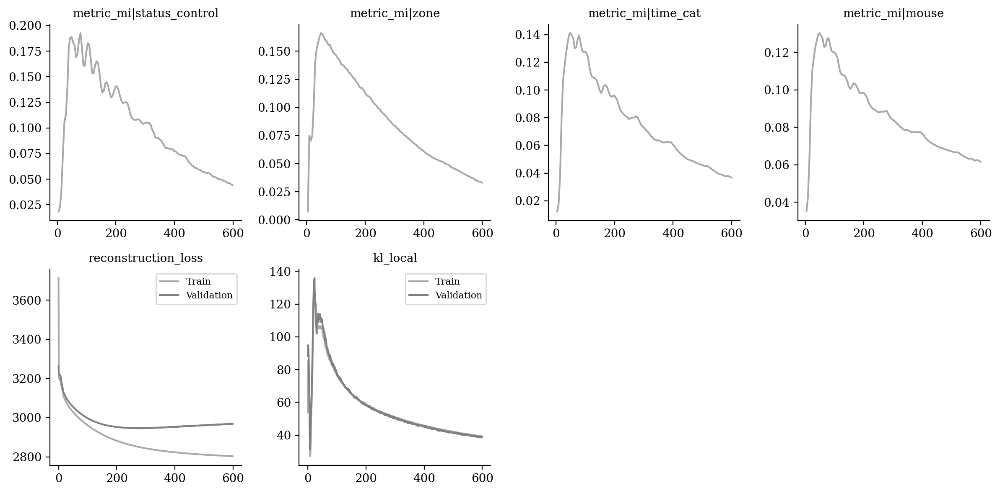

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

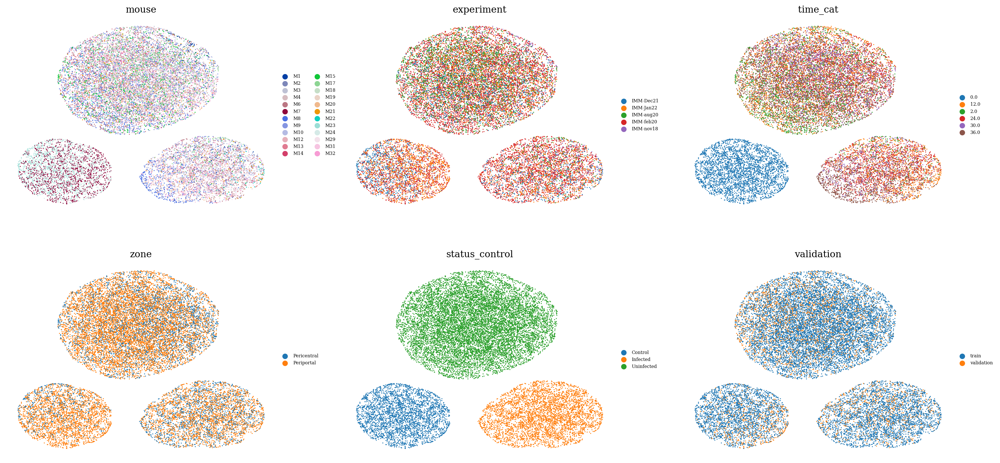

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

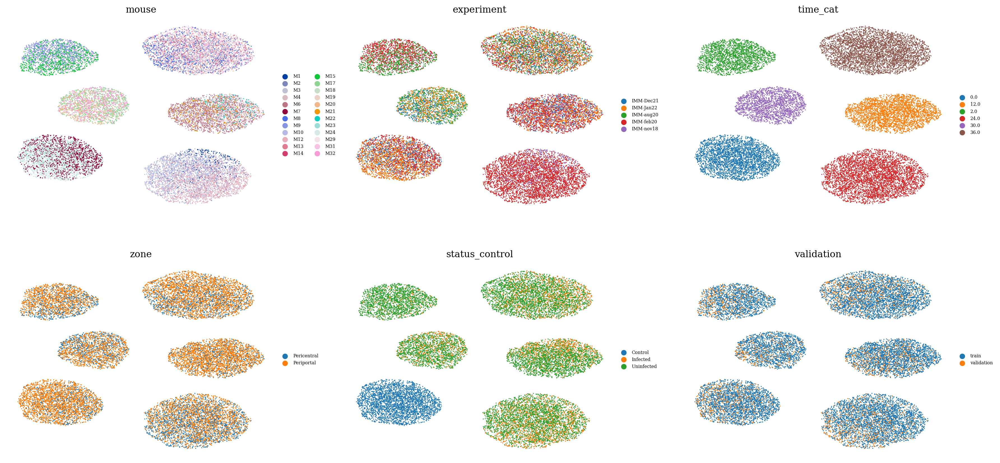

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

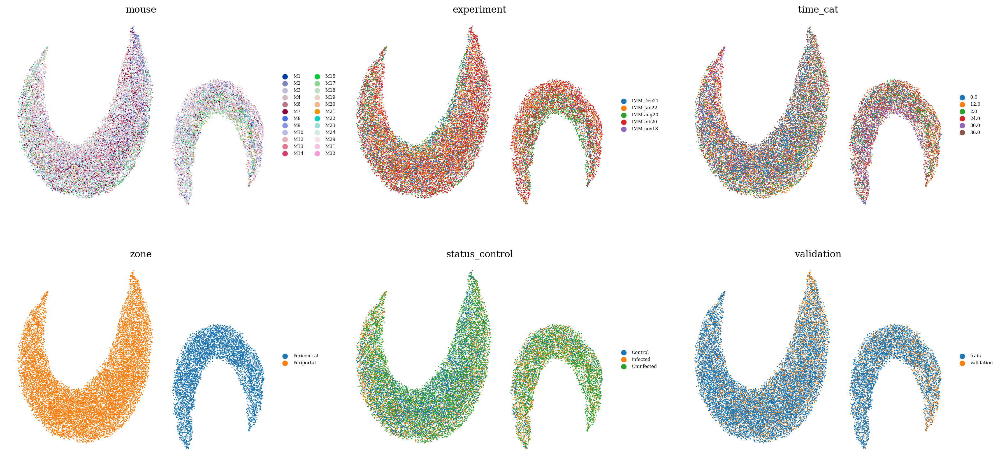

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

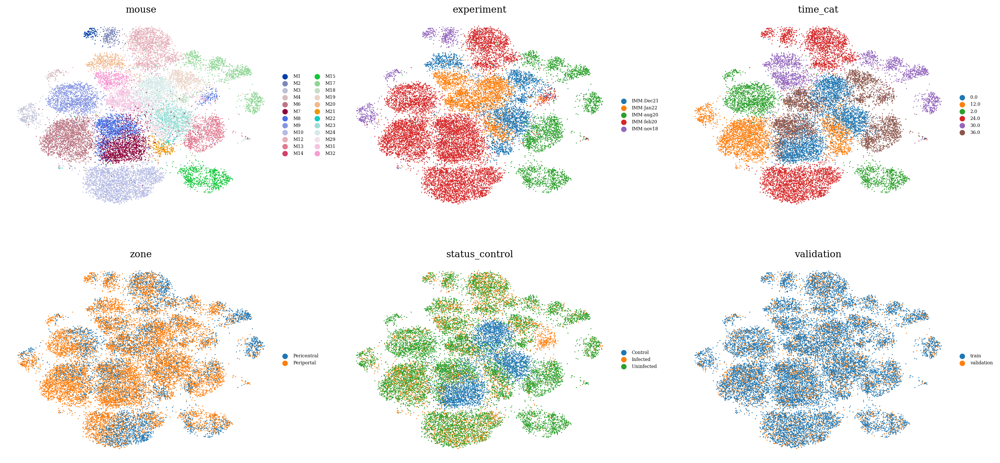

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

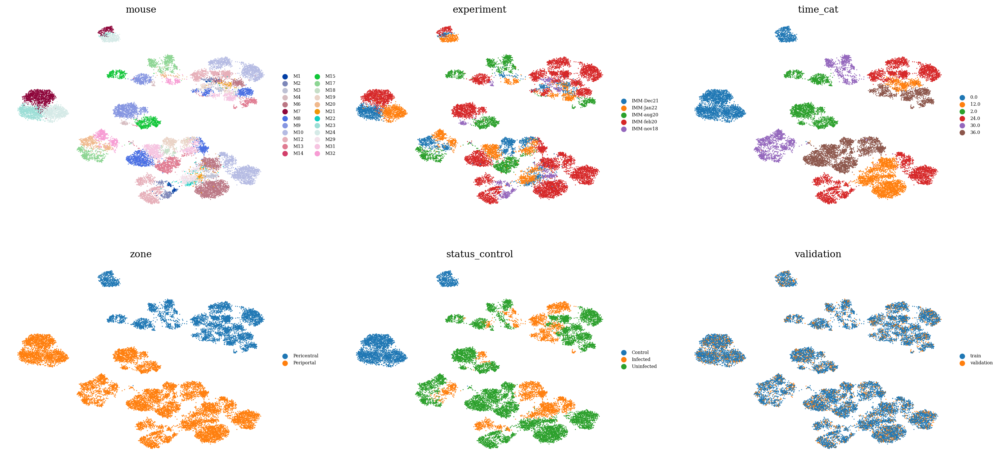

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

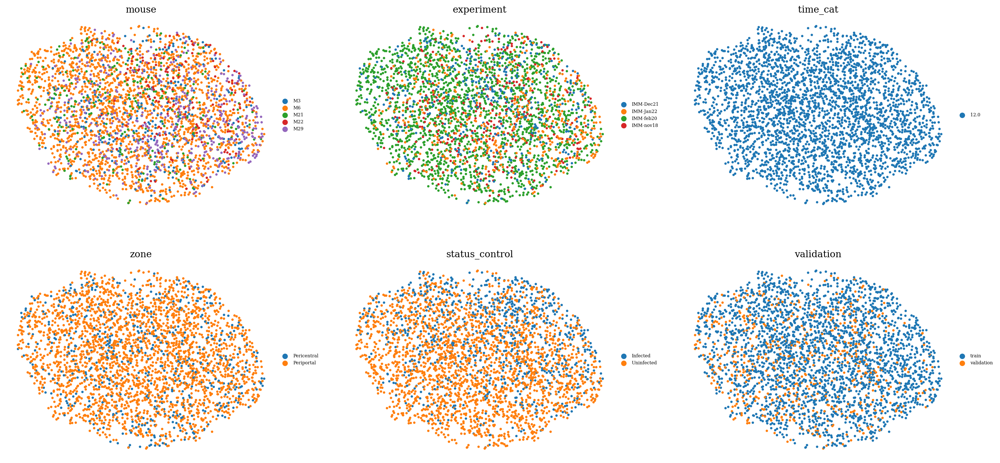

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )